In [201]:
import numpy as np
import xarray as xr
from xhistogram.xarray import histogram as xhist
from dask.diagnostics import ProgressBar
import os.path as op
from xmitgcm import open_mdsdataset
from xgcm import Grid
import scipy.interpolate as naiso

from matplotlib import gridspec as gs
import matplotlib.pyplot as plt
import matplotlib.colors as clr
%matplotlib inline

In [2]:
ddir = '/swot/SUM01/takaya/ftle/runs/'

In [3]:
def vector_gradient(x, y, x0, y0):
    ny, nx = x.shape
    grad = np.empty((ny,nx,2,2))
    

    x_p = np.roll(x, -1, axis=1)
    x_m = np.roll(x, 1, axis=1)
    x0_p = np.roll(x0, -1, axis=1)
    x0_m = np.roll(x0, 1, axis=1)

    y_p = np.roll(y, -1, axis=0)
    y_m = np.roll(y, 1, axis=0)
    y0_p = np.roll(y0, -1, axis=0)
    y0_m = np.roll(y0, 1, axis=0)

    dx = x_p - x_m
    dx0 = x0_p - x0_m

    dy = y_p - y_m
    dy0 = y0_p - y0_m
    
    
    grad[:,:,0,0] = dx / dx0
    grad[:,:,0,1] = dx / dy0
    grad[:,:,1,0] = dy / dx0
    grad[:,:,1,1] = dy / dy0
    
    return grad


def calc_l1_l2(x, y, x0, y0):
    GF = vector_gradient(x,y,x0,y0)
    C = np.empty_like(GF)

    C[:,:,0,0] = GF[:,:,0,0]**2 + GF[:,:,1,0]**2
    C[:,:,0,1] = GF[:,:,0,0]*GF[:,:,0,1] + GF[:,:,1,0]*GF[:,:,1,1]
    C[:,:,1,0] = GF[:,:,0,0]*GF[:,:,0,1] + GF[:,:,1,0]*GF[:,:,1,1]
    C[:,:,1,1] = GF[:,:,0,1]**2 + GF[:,:,1,1]**2

    # calculate trace and determinant
    Tr = C[:,:,0,0] + C[:,:,1,1]
    Det = C[:,:,0,0]*C[:,:,1,1] - C[:,:,0,1]*C[:,:,1,0]

    T = np.ma.masked_invalid(Tr)
    D = np.ma.masked_invalid(Det)

    rt = 0.25*T**2 - D
    if np.any(rt < 0):
        print('There will be imaginary eigenvalues')

    # large eigenvalue and eigenvector
    lam2 = 0.5*T + np.sqrt(rt)
    # these should all be greater than 1, mask otherwise
    mask = lam2<=1.

#     # small eigenvalue and eigenvector
#     # (direct computation is numerically unstable)
#     lam1b = 0.5*T - np.sqrt(rt)

    # instead, compute as inverse of lam2
    lam1 = lam2**-1

    # apply mask to both
    lam1 = np.ma.masked_array(lam1, mask)
    lam2 = np.ma.masked_array(lam2, mask)
    
    return lam1, lam2

In [242]:
def calc_FTLE(ds, T_day, dT, direction='forward'):
    #dscoords = {k: ds.coords[k] for k in ds.coords if k not in 'time'}
    #dsdims = {k: ds.dims[k] for k in ds.dims if k not in 'time'}
    #dscoords = ds.drop('time').coords 
    #dsdims = ds.drop('time').dims 
    
    Tstep = T_day * (24.*3600)
    l1,l2 = calc_l1_l2(ds.sel(time=Tstep, method='nearest').x, ds.sel(time=Tstep, method='nearest').y,
                       ds.sel(time=0, method='nearest').x, ds.sel(time=0, method='nearest').y)
    
    if direction=='forward' or direction=='backward':
        FTLE = T_day**-1*np.log(l2)
#     elif direction == 'backward':
#         FTLE = -T_day**-1*np.log(l1)
    else:
        raise ValueError("FTLE should only be `forward` or `backward` in time.")


    ftle = xr.DataArray(FTLE, coords=ds.drop('time').coords , dims=['y0','x0'])
    
    return ftle

In [237]:
ds = xr.open_mfdataset(op.join(ddir, '002/float_trajectories_netcdf/*.nc'), 
                      concat_dim='time')
ds

/home/takaya/.conda/envs/ftle2/lib/python3.6/site-packages/xarray/backends/api.py:783: FutureWarning: In xarray version 0.13 `auto_combine` will be deprecated.
  coords=coords)
/home/takaya/.conda/envs/ftle2/lib/python3.6/site-packages/xarray/backends/api.py:783: FutureWarning: Also `open_mfdataset` will no longer accept a `concat_dim` argument.
To get equivalent behaviour from now on please use the new
`combine_nested` function instead (or the `combine='nested'` option to
`open_mfdataset`).The datasets supplied have global dimension coordinates. You may want
to use the new `combine_by_coords` function (or the
`combine='by_coords'` option to `open_mfdataset` to order the datasets
before concatenation. Alternatively, to continue concatenating based
on the order the datasets are supplied in in future, please use the
new `combine_nested` function (or the `combine='nested'` option to
open_mfdataset).
  coords=coords)


<xarray.Dataset>
Dimensions:  (time: 414, x0: 9995, y0: 9995)
Coordinates:
  * y0       (y0) float32 600.0 800.0 1000.0 ... 1999000.0 1999200.0 1999400.0
  * x0       (x0) float32 600.0 800.0 1000.0 ... 1999000.0 1999200.0 1999400.0
  * time     (time) int64 0 3600 7200 10800 ... 2332800 2419200 2505600 2592000
Data variables:
    x        (time, y0, x0) float32 dask.array<shape=(414, 9995, 9995), chunksize=(1, 9995, 9995)>
    y        (time, y0, x0) float32 dask.array<shape=(414, 9995, 9995), chunksize=(1, 9995, 9995)>
    z        (time, y0, x0) float32 dask.array<shape=(414, 9995, 9995), chunksize=(1, 9995, 9995)>
    u        (time, y0, x0) float32 dask.array<shape=(414, 9995, 9995), chunksize=(1, 9995, 9995)>
    v        (time, y0, x0) float32 dask.array<shape=(414, 9995, 9995), chunksize=(1, 9995, 9995)>
    vort     (time, y0, x0) float32 dask.array<shape=(414, 9995, 9995), chunksize=(1, 9995, 9995)>
    lavd     (time, y0, x0) float32 dask.array<shape=(414, 9995, 9995), chunk

In [241]:
ds.time[0]

<xarray.DataArray 'time' ()>
array(0)
Coordinates:
    time     int64 0

CPU times: user 66.8 ms, sys: 0 ns, total: 66.8 ms
Wall time: 63.3 ms
[########################################] | 100% Completed | 12min 13.9s


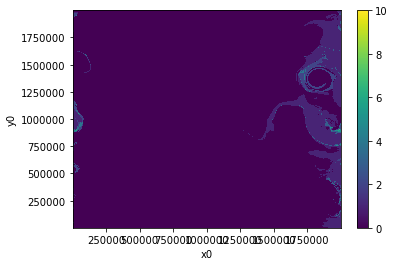

In [41]:
ds_all = ds.isel(time=slice(0,None))

%time ds_diff = ds_all.diff('time')
thresh = 1000e3       # some large number of meters, greater than any particle could
#                    reasonably travel from one snapshot to the next

with ProgressBar():
    mask = ((np.abs(ds_diff.y)>thresh) | (np.abs(ds_diff.x)>thresh)).sum('time').load()
mask.plot()

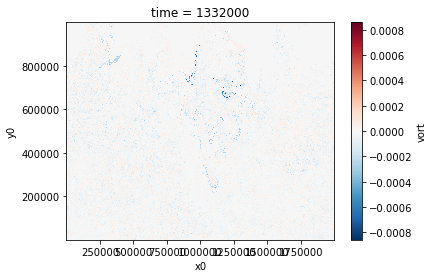

In [7]:
ds.vort[-1].plot()

In [243]:
# ds_masked = ds.where((mask==0) & (ds.vort!=0))
ds_masked = ds.where(ds.vort!=0)
# ds_masked2 = ds_masked1.where(ds_masked1.vort!=0)

direction = 'forward'
durations = [5,10,30]
FTLE = xr.concat([calc_FTLE(ds_masked, dur, dT=3600., direction=direction) for dur in durations], 
                dim=xr.Variable('duration', durations)).to_dataset(name='ftle')

# dsave = xr.merge([FTLE])
FTLE.to_netcdf(op.join(ddir,'002/ftle/%s-ftle.nc' % direction))
    
# FTLE.close()
# ds_masked1.close()
# ds_masked2.close()
# mask.close()
# ds.close()
# ds_diff.close()

/home/takaya/.conda/envs/ftle2/lib/python3.6/site-packages/ipykernel/__main__.py:12: RuntimeWarning: divide by zero encountered in log
/home/takaya/.conda/envs/ftle2/lib/python3.6/site-packages/ipykernel/__main__.py:12: RuntimeWarning: divide by zero encountered in log
/home/takaya/.conda/envs/ftle2/lib/python3.6/site-packages/ipykernel/__main__.py:12: RuntimeWarning: divide by zero encountered in log


In [244]:
# bFTLE = xr.open_dataset(op.join(ddir, '003/ftle/backward-ftle.nc'))
fFTLE = xr.open_dataset(op.join(ddir, '002/ftle/forward-ftle.nc'))
fFTLE

<xarray.Dataset>
Dimensions:   (duration: 3, x0: 9995, y0: 9995)
Coordinates:
  * y0        (y0) float32 600.0 800.0 1000.0 ... 1999000.0 1999200.0 1999400.0
  * x0        (x0) float32 600.0 800.0 1000.0 ... 1999000.0 1999200.0 1999400.0
  * duration  (duration) int32 5 10 30
Data variables:
    ftle      (duration, y0, x0) float64 ...

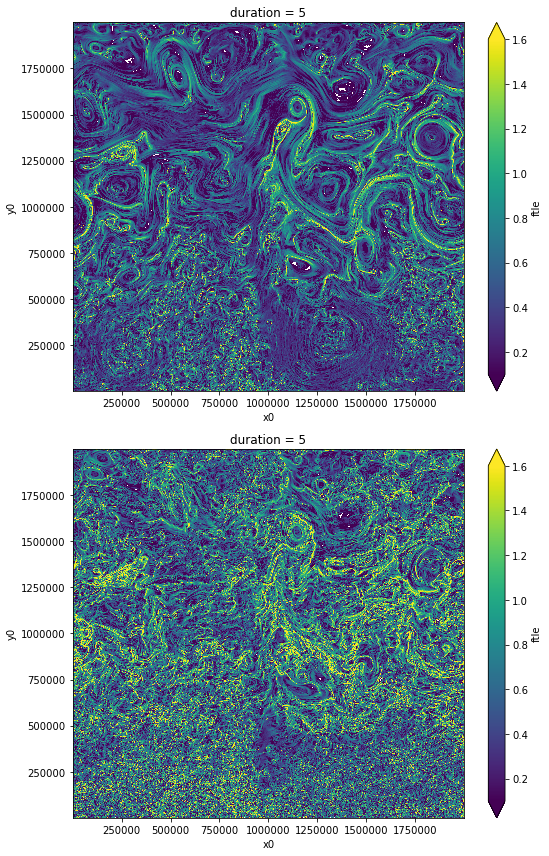

In [52]:
fig, (ax1,ax2) = plt.subplots(nrows=2, ncols=1, figsize=(8,12))
fig.set_tight_layout(True)
bFTLE.ftle[0].plot(ax=ax1, vmax=1.6, vmin=.1, rasterized=True)
fFTLE.ftle[0].plot(ax=ax2, vmax=1.6, vmin=.1, rasterized=True)
plt.savefig(op.join(ddir,'Figures/Back-For_Tau05d.pdf'))

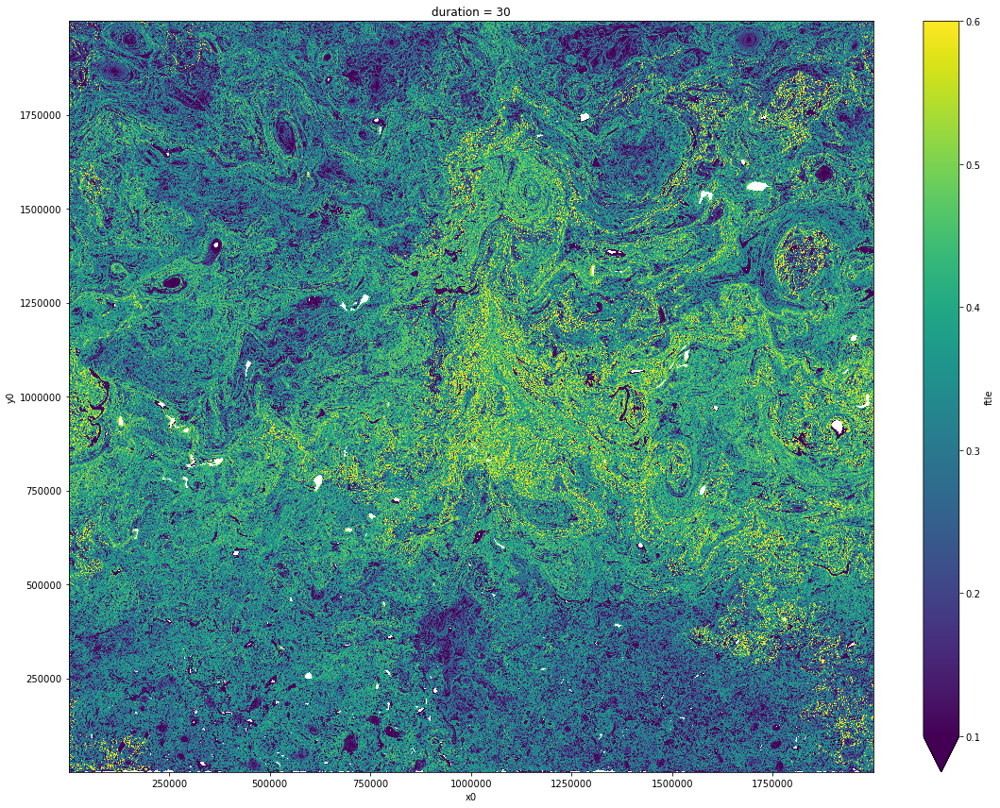

In [248]:
fig, ax = plt.subplots(figsize=(16,12))
fig.set_tight_layout(True)
fFTLE.ftle[2].plot(ax=ax, vmax=.6, vmin=.1, rasterized=True)
plt.savefig(op.join(ddir,'Figures/ForwardFTLE-wholedom_Tau30d.pdf'))

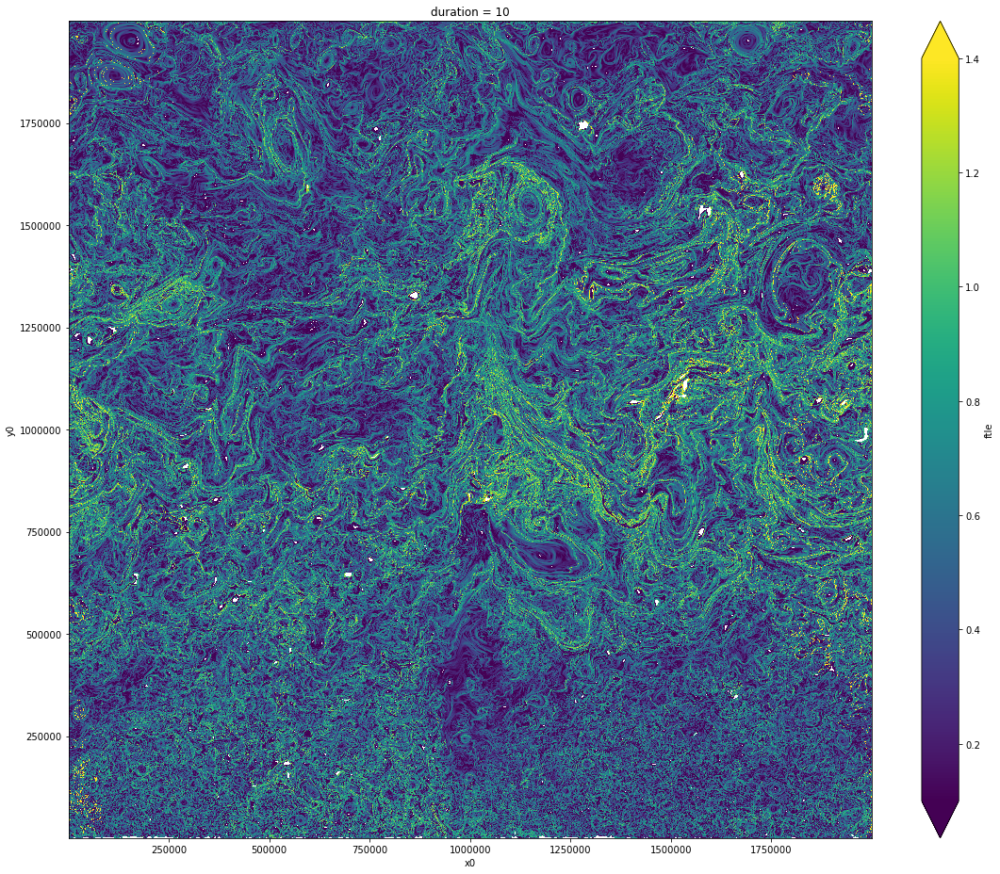

In [404]:
fig, ax = plt.subplots(figsize=(16,13))
fig.set_tight_layout(True)
fFTLE.ftle[-1].plot(ax=ax, vmax=1.4, vmin=.1, rasterized=True)
plt.savefig(op.join(ddir,'Figures/ForwardFTLE-wholedom_Tau10d.pdf'))

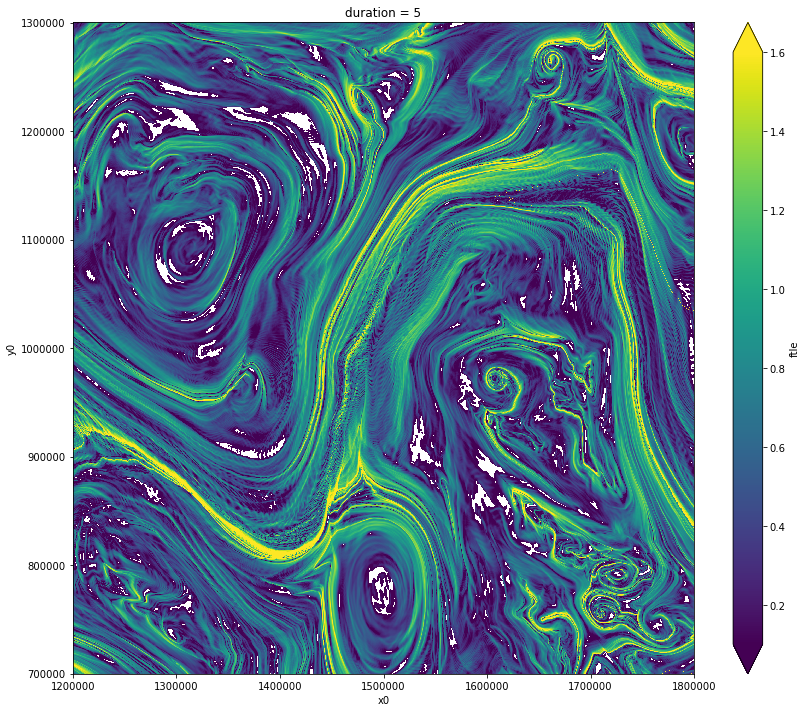

In [120]:
fig, ax = plt.subplots(figsize=(12,10))
fig.set_tight_layout(True)
bFTLE.ftle[0].sel(y0=slice(7e5,13e5),x0=slice(12e5,18e5)).plot(ax=ax, vmax=1.6, vmin=.1, rasterized=True)
plt.savefig(op.join(ddir,'Figures/BackwardFTLE-wholedom_Tau05d_y700-1300_x1200-1800.pdf'))

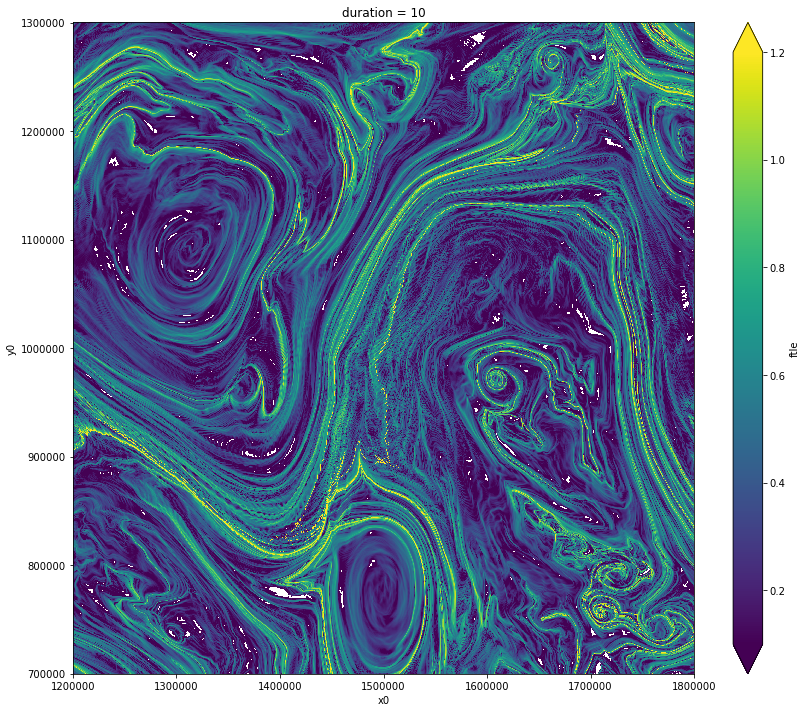

In [123]:
fig, ax = plt.subplots(figsize=(12,10))
fig.set_tight_layout(True)
bFTLE.ftle[1].sel(y0=slice(7e5,13e5),x0=slice(12e5,18e5)).plot(ax=ax, vmax=1.2, vmin=.1, rasterized=True)
plt.savefig(op.join(ddir,'Figures/BackwardFTLE-wholedom_Tau10d_y700-1300_x1200-1800.pdf'))

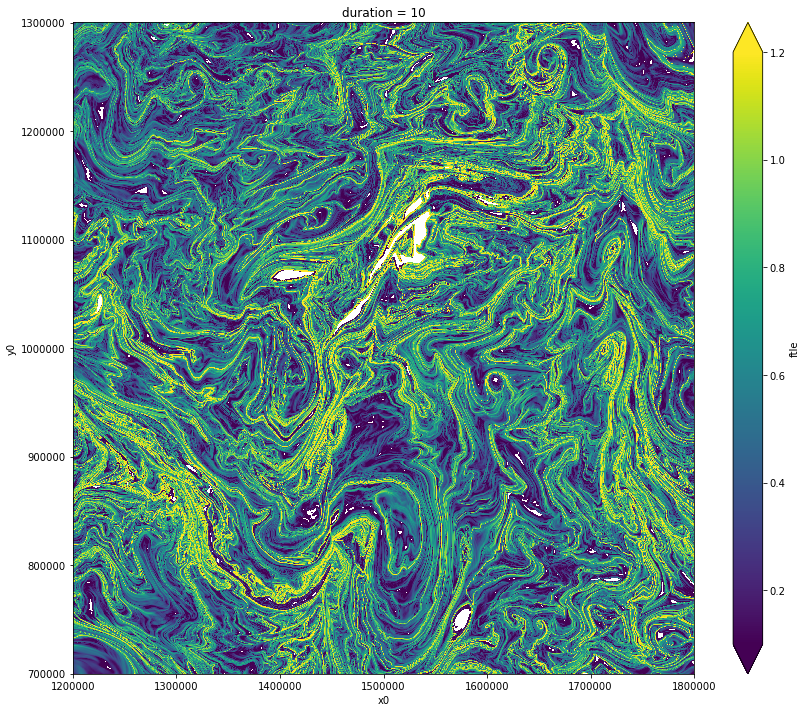

In [124]:
fig, ax = plt.subplots(figsize=(12,10))
fig.set_tight_layout(True)
fFTLE.ftle[1].sel(y0=slice(7e5,13e5),x0=slice(12e5,18e5)).plot(ax=ax, vmax=1.2, vmin=.1, rasterized=True)
plt.savefig(op.join(ddir,'Figures/ForwardFTLE-wholedom_Tau10d_y700-1300_x1200-1800.pdf'))

In [6]:
veldir = '/swot/SUM04/dbalwada/channel_beta/01km'
dt = 40
df = int(3600/40)
dfend = 378000
veliter = np.arange(int(dfend-31*86400/dt),dfend,df)[:int(5*24)]
dsnap = open_mdsdataset(op.join(veldir, 'tracer_exp2'),
                        iters = veliter,
                        prefix=['U','V','W','PH','T','PTRACER01'], delta_t=dt
                        )
#                     .sel(XC=slice(None,6e5),XG=slice(None,6e5),
#                          YC=slice(2e5,8e5),YG=slice(2e5,8e5),
#                              Z=slice(None,-1000), Zl=slice(None,-1000), Zp1=slice(None,-1016), Zu=slice(None,-1016)
#                          )
u = dsnap.U
v = dsnap.V
grid = Grid(dsnap, periodic=['X'])
dsnap

/home/takaya/.conda/envs/ftle2/lib/python3.6/site-packages/xmitgcm-0.3.0+4.g5324648-py3.6.egg/xmitgcm/mds_store.py:217: FutureWarning: In xarray version 0.13 `auto_combine` will be deprecated.
  ds = xr.auto_combine(datasets)
/home/takaya/.conda/envs/ftle2/lib/python3.6/site-packages/xmitgcm-0.3.0+4.g5324648-py3.6.egg/xmitgcm/mds_store.py:217: FutureWarning: The datasets supplied have global dimension coordinates. You may want
to use the new `combine_by_coords` function (or the
`combine='by_coords'` option to `open_mfdataset` to order the datasets
before concatenation. Alternatively, to continue concatenating based
on the order the datasets are supplied in in future, please use the
new `combine_nested` function (or the `combine='nested'` option to
open_mfdataset).The datasets supplied require both concatenation and merging. From
xarray version 0.14 this will operation will require either using the
new `combine_nested` function (or the `combine='nested'` option to
open_mfdataset), with 

<xarray.Dataset>
Dimensions:              (XC: 2000, XG: 2000, YC: 2000, YG: 2000, Z: 76, Zl: 76, Zp1: 77, Zu: 76, layer_1TH_bounds: 43, layer_1TH_center: 42, layer_1TH_interface: 41, time: 120)
Coordinates:
  * XC                   (XC) >f4 500.0 1500.0 2500.0 ... 1998500.0 1999500.0
  * YC                   (YC) >f4 500.0 1500.0 2500.0 ... 1998500.0 1999500.0
  * XG                   (XG) >f4 0.0 1000.0 2000.0 ... 1998000.0 1999000.0
  * YG                   (YG) >f4 0.0 1000.0 2000.0 ... 1998000.0 1999000.0
  * Z                    (Z) >f4 -0.5 -1.57 -2.79 ... -2757.325 -2912.665
  * Zp1                  (Zp1) >f4 0.0 -1.0 -2.14 ... -2689.32 -2825.33 -3000.0
  * Zu                   (Zu) >f4 -1.0 -2.14 -3.44 ... -2689.32 -2825.33 -3000.0
  * Zl                   (Zl) >f4 0.0 -1.0 -2.14 ... -2562.59 -2689.32 -2825.33
    rA                   (YC, XC) >f4 dask.array<shape=(2000, 2000), chunksize=(2000, 2000)>
    dxG                  (YG, XC) >f4 dask.array<shape=(2000, 2000), chunksi

In [8]:
f0 = -1.1e-4
beta = 1.4e-11
g = 9.81
r0 = 1e3
alpha = 2e-4
fC = f0 + beta*(dsnap.YC-10e5)
fG = f0 + beta*(dsnap.YG-10e5)
psi = dsnap.PH*fC**-1
ug = -grid.diff(psi*grid.interp(dsnap.dxC,'X'),'Y',boundary='fill')/dsnap.rAs
vg = grid.diff(psi*grid.interp(dsnap.dyC,'Y',boundary='fill'),'X')/dsnap.rAw
print(ug,vg)

<xarray.DataArray (time: 120, Z: 76, YG: 2000, XC: 2000)>
dask.array<shape=(120, 76, 2000, 2000), dtype=float32, chunksize=(1, 76, 1, 1999)>
Coordinates:
  * time     (time) int64 12441600 12445200 12448800 ... 12866400 12870000
  * Z        (Z) >f4 -0.5 -1.57 -2.79 -4.185 ... -2625.955 -2757.325 -2912.665
  * YG       (YG) >f4 0.0 1000.0 2000.0 3000.0 ... 1997000.0 1998000.0 1999000.0
  * XC       (XC) >f4 500.0 1500.0 2500.0 ... 1997500.0 1998500.0 1999500.0
    dxG      (YG, XC) >f4 dask.array<shape=(2000, 2000), chunksize=(2000, 2000)>
    dyC      (YG, XC) >f4 dask.array<shape=(2000, 2000), chunksize=(2000, 2000)>
    rAs      (YG, XC) >f4 dask.array<shape=(2000, 2000), chunksize=(2000, 2000)> <xarray.DataArray (time: 120, Z: 76, YC: 2000, XG: 2000)>
dask.array<shape=(120, 76, 2000, 2000), dtype=float32, chunksize=(1, 76, 1999, 1)>
Coordinates:
  * time     (time) int64 12441600 12445200 12448800 ... 12866400 12870000
  * Z        (Z) >f4 -0.5 -1.57 -2.79 -4.185 ... -2625.955 -275

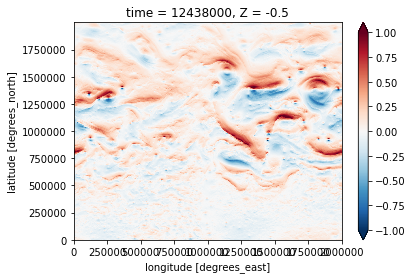

In [35]:
ug[0,0].plot(vmax=1)

In [9]:
ud = grid.interp(u,'X') - grid.interp(ug,'Y',boundary='fill')
vd = grid.interp(v,'Y',boundary='fill') - grid.interp(vg,'X')
print(ud,vd)

<xarray.DataArray (time: 120, Z: 76, YC: 2000, XC: 2000)>
dask.array<shape=(120, 76, 2000, 2000), dtype=float32, chunksize=(1, 76, 1, 1999)>
Coordinates:
  * time     (time) int64 12441600 12445200 12448800 ... 12866400 12870000
  * Z        (Z) >f4 -0.5 -1.57 -2.79 -4.185 ... -2625.955 -2757.325 -2912.665
  * YC       (YC) >f4 500.0 1500.0 2500.0 ... 1997500.0 1998500.0 1999500.0
  * XC       (XC) >f4 500.0 1500.0 2500.0 ... 1997500.0 1998500.0 1999500.0 <xarray.DataArray (time: 120, Z: 76, YC: 2000, XC: 2000)>
dask.array<shape=(120, 76, 2000, 2000), dtype=float32, chunksize=(1, 76, 1999, 1)>
Coordinates:
  * time     (time) int64 12441600 12445200 12448800 ... 12866400 12870000
  * Z        (Z) >f4 -0.5 -1.57 -2.79 -4.185 ... -2625.955 -2757.325 -2912.665
  * YC       (YC) >f4 500.0 1500.0 2500.0 ... 1997500.0 1998500.0 1999500.0
  * XC       (XC) >f4 500.0 1500.0 2500.0 ... 1997500.0 1998500.0 1999500.0


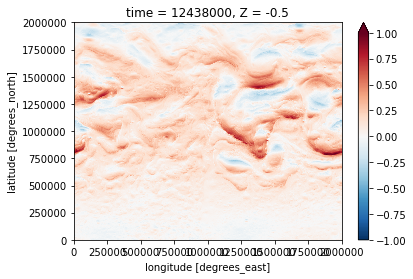

In [36]:
ud[0,0].plot(vmax=1.)

In [341]:
N2 = alpha*g * -(grid.diff(dsnap['T'],'Z',boundary='fill')
                 / dsnap.drC.data[np.newaxis,:-1,np.newaxis,np.newaxis])
N2

<xarray.DataArray (time: 120, Zl: 76, YC: 2000, XC: 2000)>
dask.array<shape=(120, 76, 2000, 2000), dtype=float32, chunksize=(1, 1, 2000, 2000)>
Coordinates:
  * time     (time) int64 12441600 12445200 12448800 ... 12866400 12870000
  * Zl       (Zl) >f4 0.0 -1.0 -2.14 -3.44 ... -2562.59 -2689.32 -2825.33
  * YC       (YC) >f4 500.0 1500.0 2500.0 ... 1997500.0 1998500.0 1999500.0
  * XC       (XC) >f4 500.0 1500.0 2500.0 ... 1997500.0 1998500.0 1999500.0

[########################################] | 100% Completed | 14.1s


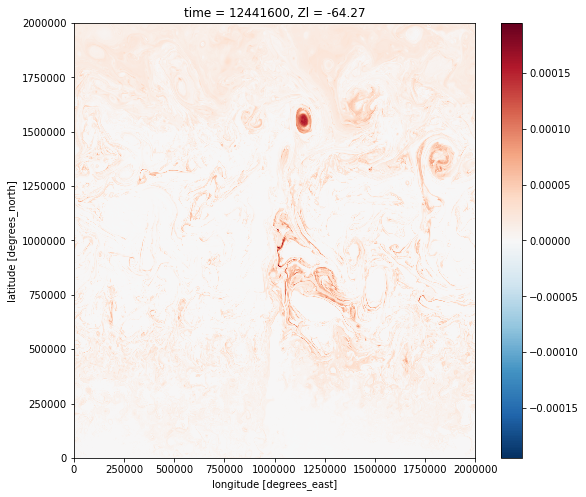

In [342]:
with ProgressBar():
    N2[nt,nz70].plot(figsize=(9,8))

In [339]:
# h = 1e3*(1-alpha*(dsnap['T']+273.15))
# hx = grid.diff(h*grid.interp(dsnap.dyC,'Y',boundary='fill'),'X')/dsnap.rAw
# hy = grid.diff(h*grid.interp(dsnap.dxC,'X'),'Y',boundary='fill')/dsnap.rAs
# ht = h.diff('time')/3600.
# ht = xr.DataArray(.5*(ht+ht.shift(time=-1)).data, dims=h[1:].dims, coords=h[1:].coords)
b = -grid.diff(dsnap.PH,'Z',boundary='fill')/dsnap.drC.data[np.newaxis,:-1,np.newaxis,np.newaxis]
bx = grid.diff(b*grid.interp(dsnap.dyC,'Y',boundary='fill'),
               'X')/dsnap.rAw
by = grid.diff(b*grid.interp(dsnap.dxC,'X'),
               'Y',boundary='fill')/dsnap.rAs
bz = -grid.diff(b,'Z',boundary='fill')/dsnap.drF
hx = grid.interp(grid.interp(bx,'Z',boundary='fill'),
                 'X')/bz
hy = grid.interp(grid.interp(by,'Z',boundary='fill'),
                 'Y',boundary='fill')/bz
print(hx,hy)

<xarray.DataArray (time: 120, Z: 76, YC: 2000, XC: 2000)>
dask.array<shape=(120, 76, 2000, 2000), dtype=float32, chunksize=(1, 1, 1999, 1)>
Coordinates:
  * time     (time) int64 12441600 12445200 12448800 ... 12866400 12870000
  * Z        (Z) >f4 -0.5 -1.57 -2.79 -4.185 ... -2625.955 -2757.325 -2912.665
  * YC       (YC) >f4 500.0 1500.0 2500.0 ... 1997500.0 1998500.0 1999500.0
  * XC       (XC) >f4 500.0 1500.0 2500.0 ... 1997500.0 1998500.0 1999500.0
    drF      (Z) >f4 dask.array<shape=(76,), chunksize=(76,)>
    PHrefC   (Z) >f4 dask.array<shape=(76,), chunksize=(76,)> <xarray.DataArray (time: 120, Z: 76, YC: 2000, XC: 2000)>
dask.array<shape=(120, 76, 2000, 2000), dtype=float32, chunksize=(1, 1, 1, 1999)>
Coordinates:
  * time     (time) int64 12441600 12445200 12448800 ... 12866400 12870000
  * Z        (Z) >f4 -0.5 -1.57 -2.79 -4.185 ... -2625.955 -2757.325 -2912.665
  * YC       (YC) >f4 500.0 1500.0 2500.0 ... 1997500.0 1998500.0 1999500.0
  * XC       (XC) >f4 500.0 1500.0

[########################################] | 100% Completed |  7.6s
[########################################] | 100% Completed |  0.1s
[########################################] | 100% Completed |  0.1s


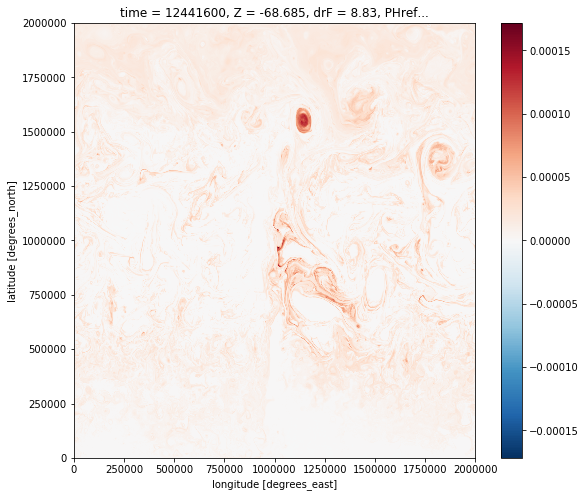

In [343]:
with ProgressBar():
    bz[nt,nz70].plot(figsize=(9,8))

[#################################       ] | 84% Completed |  7.7s

/home/takaya/.conda/envs/ftle2/lib/python3.6/site-packages/dask/core.py:119: RuntimeWarning: divide by zero encountered in true_divide
  return func(*args2)
/home/takaya/.conda/envs/ftle2/lib/python3.6/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in true_divide
  return func(*args2)


[########################################] | 100% Completed | 13.6s
[########################################] | 100% Completed |  0.1s
[########################################] | 100% Completed |  0.1s


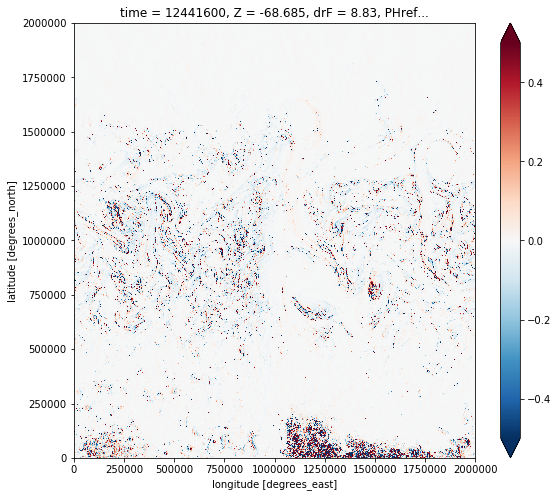

In [347]:
with ProgressBar():
    hx[nt,nz70].plot(figsize=(9,8), vmax=.5)

In [327]:
dsnap.Z

<xarray.DataArray 'Z' (Z: 76)>
array([-5.000000e-01, -1.570000e+00, -2.790000e+00, -4.185000e+00,
       -5.780000e+00, -7.595000e+00, -9.660000e+00, -1.201000e+01,
       -1.468000e+01, -1.770500e+01, -2.112500e+01, -2.499000e+01,
       -2.934500e+01, -3.424000e+01, -3.972500e+01, -4.585500e+01,
       -5.269000e+01, -6.028000e+01, -6.868500e+01, -7.796500e+01,
       -8.817500e+01, -9.937000e+01, -1.116000e+02, -1.249150e+02,
       -1.393650e+02, -1.549900e+02, -1.718250e+02, -1.899000e+02,
       -2.092350e+02, -2.298550e+02, -2.517700e+02, -2.749850e+02,
       -2.995050e+02, -3.253200e+02, -3.524200e+02, -3.807900e+02,
       -4.104100e+02, -4.412550e+02, -4.733050e+02, -5.065400e+02,
       -5.409350e+02, -5.764650e+02, -6.131100e+02, -6.508550e+02,
       -6.896850e+02, -7.295950e+02, -7.705850e+02, -8.126600e+02,
       -8.558350e+02, -9.001350e+02, -9.455950e+02, -9.922600e+02,
       -1.040180e+03, -1.089425e+03, -1.140080e+03, -1.192235e+03,
       -1.246005e+03, -1.301520

In [331]:
nt = 0
# wiso = ((ud*hx + vd*hy)[nt]
#         + ((hx**2 + hy**2)
#           / (1+(hx**2 + hy**2))
#           )[nt]
#           * (0 + (grid.interp(ug,'Y',boundary='fill')*hx
#                  + grid.interp(vg,'X')*hy
#                  )[nt]
#             )
#        )
# wiso = ((grid.interp(ud*hx + vd*hy,'Z',boundary='fill')[nt] 
#          + dsnap.W[nt]*grid.interp(hx**2 + hy**2,'Z',boundary='fill')[nt]
#         )
#         / (1 + grid.interp(hx**2 + hy**2,'Z',boundary='fill')[nt])
#        )
wiso = grid.interp(u,'X')*hx + grid.interp(v,'Y',boundary='fill')*hy
nz70 = 18
nz100 = 21
nz200 = 28
nz400 = 36
with ProgressBar():
    wiso0 = wiso[nt,0].compute()
    wiso70 = wiso[nt,nz70].compute()
    wiso100 = wiso[nt,nz100].compute()
    wiso200 = wiso[nt,nz200].compute()
    wiso400 = wiso[nt,nz400].compute()
wiso

[#############################           ] | 74% Completed |  5.8s

/home/takaya/.conda/envs/ftle2/lib/python3.6/site-packages/dask/core.py:119: RuntimeWarning: divide by zero encountered in true_divide
  return func(*args2)
/home/takaya/.conda/envs/ftle2/lib/python3.6/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in multiply
  return func(*args2)


[################################        ] | 81% Completed |  9.2s

/home/takaya/.conda/envs/ftle2/lib/python3.6/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in true_divide
  return func(*args2)


[########################################] | 100% Completed | 10.4s
[##############################          ] | 76% Completed |  8.2s

/home/takaya/.conda/envs/ftle2/lib/python3.6/site-packages/dask/core.py:119: RuntimeWarning: divide by zero encountered in true_divide
  return func(*args2)
/home/takaya/.conda/envs/ftle2/lib/python3.6/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in multiply
  return func(*args2)
/home/takaya/.conda/envs/ftle2/lib/python3.6/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in true_divide
  return func(*args2)


[##################################      ] | 86% Completed | 11.4s

/home/takaya/.conda/envs/ftle2/lib/python3.6/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in add
  return func(*args2)


[########################################] | 100% Completed | 18.2s
[##############################          ] | 76% Completed |  8.4s

/home/takaya/.conda/envs/ftle2/lib/python3.6/site-packages/dask/core.py:119: RuntimeWarning: divide by zero encountered in true_divide
  return func(*args2)
/home/takaya/.conda/envs/ftle2/lib/python3.6/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in multiply
  return func(*args2)
/home/takaya/.conda/envs/ftle2/lib/python3.6/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in true_divide
  return func(*args2)


[##################################      ] | 86% Completed | 11.2s

/home/takaya/.conda/envs/ftle2/lib/python3.6/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in add
  return func(*args2)


[########################################] | 100% Completed | 17.9s
[##############################          ] | 76% Completed |  8.7s

/home/takaya/.conda/envs/ftle2/lib/python3.6/site-packages/dask/core.py:119: RuntimeWarning: divide by zero encountered in true_divide
  return func(*args2)
/home/takaya/.conda/envs/ftle2/lib/python3.6/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in multiply
  return func(*args2)
/home/takaya/.conda/envs/ftle2/lib/python3.6/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in true_divide
  return func(*args2)


[##################################      ] | 86% Completed | 11.9s

/home/takaya/.conda/envs/ftle2/lib/python3.6/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in add
  return func(*args2)


[########################################] | 100% Completed | 18.7s
[##############################          ] | 76% Completed |  8.8s

/home/takaya/.conda/envs/ftle2/lib/python3.6/site-packages/dask/core.py:119: RuntimeWarning: divide by zero encountered in true_divide
  return func(*args2)
/home/takaya/.conda/envs/ftle2/lib/python3.6/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in multiply
  return func(*args2)
/home/takaya/.conda/envs/ftle2/lib/python3.6/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in true_divide
  return func(*args2)


[##################################      ] | 86% Completed | 11.7s

/home/takaya/.conda/envs/ftle2/lib/python3.6/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in add
  return func(*args2)


[########################################] | 100% Completed | 18.7s


<xarray.DataArray (time: 120, Z: 76, YC: 2000, XC: 2000)>
dask.array<shape=(120, 76, 2000, 2000), dtype=float32, chunksize=(1, 1, 1, 1)>
Coordinates:
  * time     (time) int64 12441600 12445200 12448800 ... 12866400 12870000
  * Z        (Z) >f4 -0.5 -1.57 -2.79 -4.185 ... -2625.955 -2757.325 -2912.665
  * YC       (YC) >f4 500.0 1500.0 2500.0 ... 1997500.0 1998500.0 1999500.0
  * XC       (XC) >f4 500.0 1500.0 2500.0 ... 1997500.0 1998500.0 1999500.0
    drF      (Z) >f4 dask.array<shape=(76,), chunksize=(76,)>
    PHrefC   (Z) >f4 dask.array<shape=(76,), chunksize=(76,)>

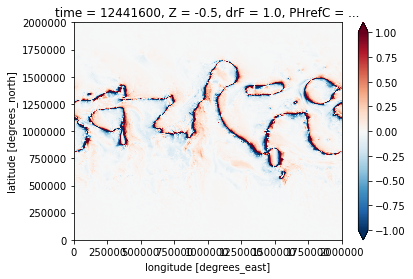

In [314]:
(wiso0*86400).plot(vmax=1.)

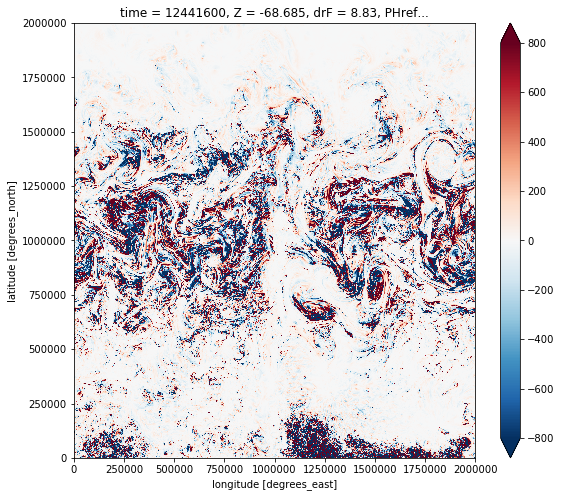

In [337]:
(wiso70*86400).plot(vmax=8e2, figsize=(9,8))

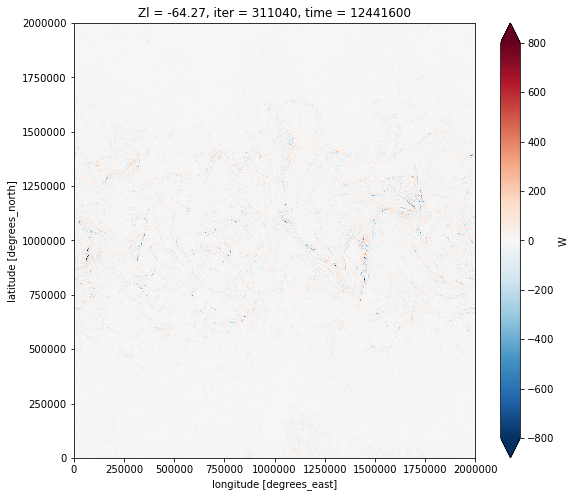

In [338]:
(dsnap.W[nt,nz70]*86400).plot(vmax=8e2, figsize=(9,8))

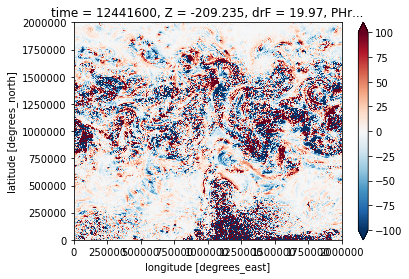

In [325]:
(wiso200*86400).plot(vmax=1e2)

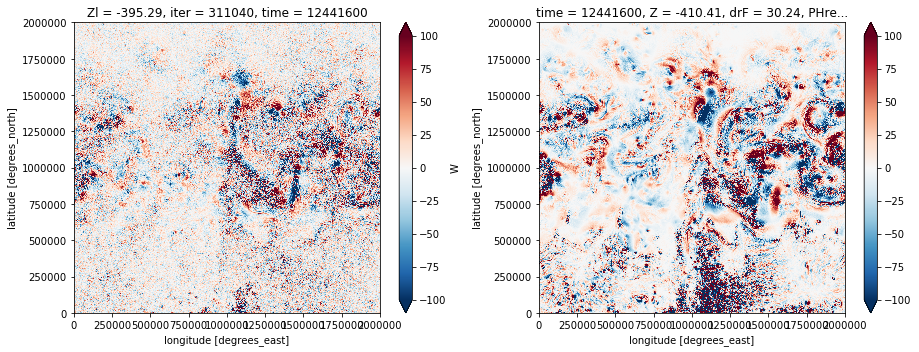

In [315]:
fig, (ax1,ax2) = plt.subplots(nrows=1, ncols=2, figsize=(13,5))
fig.set_tight_layout(True)
(dsnap.W[nt,nz400]*86400).plot(ax=ax1, vmax=1e2)
(wiso400*86400).plot(ax=ax2, vmax=1e2)

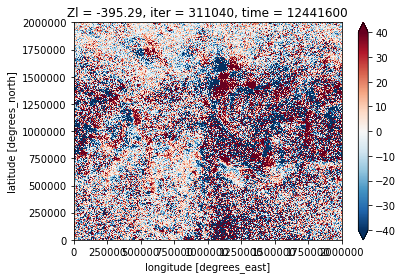

In [125]:
((dsnap.W[nt,nz400]-wiso400)*86400).plot(vmax=40.)

In [288]:
wisoC = wiso*dsnap.PTRACER01
wisoC

<xarray.DataArray (time: 120, Z: 76, YC: 2000, XC: 2000)>
dask.array<shape=(120, 76, 2000, 2000), dtype=float32, chunksize=(1, 1, 1, 1)>
Coordinates:
  * time     (time) int64 12441600 12445200 12448800 ... 12866400 12870000
  * Z        (Z) >f4 -0.5 -1.57 -2.79 -4.185 ... -2625.955 -2757.325 -2912.665
  * YC       (YC) >f4 500.0 1500.0 2500.0 ... 1997500.0 1998500.0 1999500.0
  * XC       (XC) >f4 500.0 1500.0 2500.0 ... 1997500.0 1998500.0 1999500.0
    drF      (Z) >f4 dask.array<shape=(76,), chunksize=(76,)>
    PHrefC   (Z) >f4 dask.array<shape=(76,), chunksize=(76,)>
    rA       (YC, XC) >f4 dask.array<shape=(2000, 2000), chunksize=(2000, 2000)>
    Depth    (YC, XC) >f4 dask.array<shape=(2000, 2000), chunksize=(2000, 2000)>
    hFacC    (Z, YC, XC) >f4 dask.array<shape=(76, 2000, 2000), chunksize=(76, 2000, 2000)>
    maskC    (Z, YC, XC) bool dask.array<shape=(76, 2000, 2000), chunksize=(76, 2000, 2000)>
    iter     (time) int64 dask.array<shape=(120,), chunksize=(1,)>

In [289]:
# wc = dsnap.W*grid.interp(dsnap.PTRACER01,'Z',boundary='fill')
# dwcdz = -grid.diff(wc,'Z',boundary='fill')/dsnap.drF
with ProgressBar():
    wisoC400 = wisoC[nt,nz400].sel(XC=slice(12e5,18e5),YC=slice(7e5,13e5)).compute()
    wisoC200 = wisoC[nt,nz200].sel(XC=slice(12e5,18e5),YC=slice(7e5,13e5)).compute()
#     dwisocdz400 = dwcdz[:,36].sel(XC=slice(2e5,8e5),YC=slice(7e5,13e5)).compute()
# dwcdz400
wisoC400

[#####################################   ] | 94% Completed | 15.1s

/home/takaya/.conda/envs/ftle2/lib/python3.6/site-packages/dask/core.py:119: RuntimeWarning: divide by zero encountered in true_divide
  return func(*args2)
/home/takaya/.conda/envs/ftle2/lib/python3.6/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in true_divide
  return func(*args2)


[####################################### ] | 98% Completed | 18.9s

/home/takaya/.conda/envs/ftle2/lib/python3.6/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in add
  return func(*args2)


[########################################] | 100% Completed | 21.3s
[#####################################   ] | 94% Completed | 17.9s

/home/takaya/.conda/envs/ftle2/lib/python3.6/site-packages/dask/core.py:119: RuntimeWarning: divide by zero encountered in true_divide
  return func(*args2)
/home/takaya/.conda/envs/ftle2/lib/python3.6/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in true_divide
  return func(*args2)


[####################################### ] | 98% Completed | 22.4s

/home/takaya/.conda/envs/ftle2/lib/python3.6/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in add
  return func(*args2)


[########################################] | 100% Completed | 24.2s


<xarray.DataArray (YC: 600, XC: 600)>
array([[-6.625060e-07, -5.739089e-06, -8.896301e-06, ...,  5.060697e-07,
        -3.014782e-06, -5.487094e-06],
       [-4.698975e-06, -9.674807e-06, -1.273614e-05, ..., -9.374707e-07,
        -3.711015e-06, -8.121837e-07],
       [-1.392627e-05, -1.890990e-05, -2.213089e-05, ..., -4.025121e-06,
        -1.021008e-06,  6.001147e-06],
       ...,
       [ 2.198147e-05,  2.660325e-05,  2.032332e-05, ...,  2.306541e-04,
         2.319739e-04,  1.085417e-04],
       [ 2.166530e-06,  9.737623e-06,  1.100014e-05, ...,  1.994152e-04,
         1.748398e-04,  6.352998e-05],
       [-1.068827e-05, -6.720945e-06, -4.092533e-06, ...,  1.684875e-04,
         1.239768e-04,  3.777608e-05]], dtype=float32)
Coordinates:
    time     int64 12441600
    Z        >f4 -410.41
  * YC       (YC) >f4 700500.0 701500.0 702500.0 ... 1298500.0 1299500.0
  * XC       (XC) >f4 1200500.0 1201500.0 1202500.0 ... 1798500.0 1799500.0
    drF      float32 30.24
    PHrefC   float32

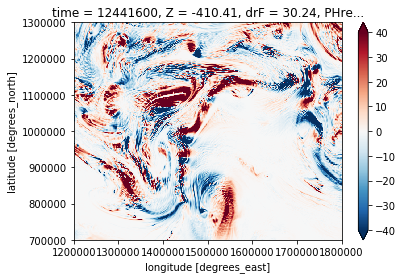

In [292]:
# (wisoC400*86400).plot(norm=clr.SymLogNorm(0.01, vmin=-4e1, vmax=4e1))
(wisoC400*86400).plot(vmin=-40, vmax=40, cmap='RdBu_r')

In [55]:
ux = grid.diff(u[nt,0]*dsnap.dyG,'X')*dsnap.rA**-1
vx = grid.diff(v[nt,0]*dsnap.dyC,'X')*dsnap.rAz**-1
uy = grid.diff(u[nt,0]*dsnap.dxC,'Y',boundary='fill')*dsnap.rAz**-1
vy = grid.diff(v[nt,0]*dsnap.dxG,'Y',boundary='fill')*dsnap.rA**-1
print(ux.dims, vx.dims, uy.dims, vy.dims)
with ProgressBar():
    strain = grid.interp(grid.interp(np.sqrt(grid.interp(grid.interp((ux-vy)**2,'X',boundary='fill'),
                                                         'Y',boundary='fill') 
                                    + (vx+uy)**2),'X'),'Y',boundary='fill'
                        ).sel(XC=slice(12e5,18e5),YC=slice(7e5,13e5)).compute()
strain

('YC', 'XC') ('YG', 'XG') ('YG', 'XG') ('YC', 'XC')
[########################################] | 100% Completed |  0.1s
[########################################] | 100% Completed |  0.1s
[########################################] | 100% Completed |  0.1s
[########################################] | 100% Completed | 19.2s


<xarray.DataArray 'mul-e44c8e029cf3425817a76d478571ec90' (YC: 600, XC: 600)>
array([[1.499018e-05, 1.476920e-05, 1.537310e-05, ..., 1.682920e-05,
        2.494608e-05, 3.343174e-05],
       [1.472281e-05, 1.491194e-05, 1.539826e-05, ..., 2.229467e-05,
        3.113983e-05, 3.561578e-05],
       [1.429376e-05, 1.440203e-05, 1.442389e-05, ..., 2.983255e-05,
        3.346922e-05, 3.242861e-05],
       ...,
       [3.213912e-05, 3.195522e-05, 3.349189e-05, ..., 1.322923e-05,
        1.498241e-05, 1.903789e-05],
       [2.612894e-05, 2.814605e-05, 3.381011e-05, ..., 1.416101e-05,
        1.697479e-05, 2.702892e-05],
       [2.363665e-05, 2.497948e-05, 3.251840e-05, ..., 1.456820e-05,
        2.401482e-05, 3.500099e-05]], dtype=float32)
Coordinates:
  * YC       (YC) >f4 700500.0 701500.0 702500.0 ... 1298500.0 1299500.0
  * XC       (XC) >f4 1200500.0 1201500.0 1202500.0 ... 1798500.0 1799500.0

In [58]:
with ProgressBar():
    div = (ux+vy).sel(XC=slice(12e5,18e5),YC=slice(7e5,13e5)).compute()
div

[########################################] | 100% Completed |  0.1s
[########################################] | 100% Completed |  0.1s
[########################################] | 100% Completed |  2.6s


<xarray.DataArray (YC: 600, XC: 600)>
array([[ 4.850463e-07, -1.160217e-06, -3.252350e-06, ...,  3.638993e-06,
        -4.669008e-06, -1.006833e-05],
       [-2.988129e-06, -4.448120e-06, -5.082581e-06, ..., -5.109936e-06,
        -1.422178e-05, -1.135512e-05],
       [-5.932556e-06, -5.416748e-06, -4.105835e-06, ..., -7.827190e-06,
        -1.253038e-05, -4.107891e-06],
       ...,
       [ 1.041670e-05,  1.159758e-05,  6.950449e-07, ...,  2.072296e-05,
         1.319150e-05, -4.993622e-06],
       [-4.888152e-07,  6.782158e-06, -1.796982e-06, ...,  2.241239e-05,
         2.110413e-06, -1.757013e-05],
       [-8.673462e-06, -1.613075e-06, -5.088455e-06, ...,  1.162555e-05,
        -1.232449e-05, -2.734143e-05]], dtype=float32)
Coordinates:
  * YC       (YC) >f4 700500.0 701500.0 702500.0 ... 1298500.0 1299500.0
  * XC       (XC) >f4 1200500.0 1201500.0 1202500.0 ... 1798500.0 1799500.0
    rA       (YC, XC) >f4 1000000.0 1000000.0 1000000.0 ... 1000000.0 1000000.0
    Depth    (YC, XC

In [130]:
ux400 = grid.diff(u[nt,nz400]*dsnap.dyG,'X')*dsnap.rA**-1
# vx = grid.diff(v[nt,0]*dsnap.dyC,'X')*dsnap.rAz**-1
# uy = grid.diff(u[nt,0]*dsnap.dxC,'Y',boundary='fill')*dsnap.rAz**-1
vy400 = grid.diff(v[nt,nz400]*dsnap.dxG,'Y',boundary='fill')*dsnap.rA**-1
print(ux.dims, vx.dims, uy.dims, vy.dims)
with ProgressBar():
    div400 = (ux400+vy400).sel(XC=slice(12e5,18e5),YC=slice(7e5,13e5)).compute()
div400

('YC', 'XC') ('YG', 'XG') ('YG', 'XG') ('YC', 'XC')
[########################################] | 100% Completed |  0.1s
[########################################] | 100% Completed |  0.1s
[########################################] | 100% Completed |  2.6s


<xarray.DataArray (YC: 600, XC: 600)>
array([[ 1.796478e-06,  1.944961e-06,  2.858856e-06, ..., -4.656670e-06,
        -4.616775e-07,  4.849510e-06],
       [ 1.715729e-06,  1.688766e-06,  1.367157e-06, ...,  2.658234e-07,
         5.596008e-06,  7.491448e-06],
       [-1.555695e-06, -1.704300e-06, -2.673874e-06, ...,  6.044998e-06,
         6.323662e-06, -7.339477e-07],
       ...,
       [ 7.144242e-07,  2.812119e-07,  1.144074e-06, ...,  3.535919e-06,
        -4.770599e-06, -7.108673e-06],
       [ 1.162964e-06,  4.104463e-07,  1.612274e-06, ..., -7.665650e-06,
        -9.941070e-06, -5.672424e-06],
       [ 1.285187e-06,  2.998813e-07,  1.697167e-06, ..., -1.064178e-05,
        -7.097260e-06,  4.391495e-08]], dtype=float32)
Coordinates:
  * YC       (YC) >f4 700500.0 701500.0 702500.0 ... 1298500.0 1299500.0
  * XC       (XC) >f4 1200500.0 1201500.0 1202500.0 ... 1798500.0 1799500.0
    rA       (YC, XC) >f4 1000000.0 1000000.0 1000000.0 ... 1000000.0 1000000.0
    Depth    (YC, XC

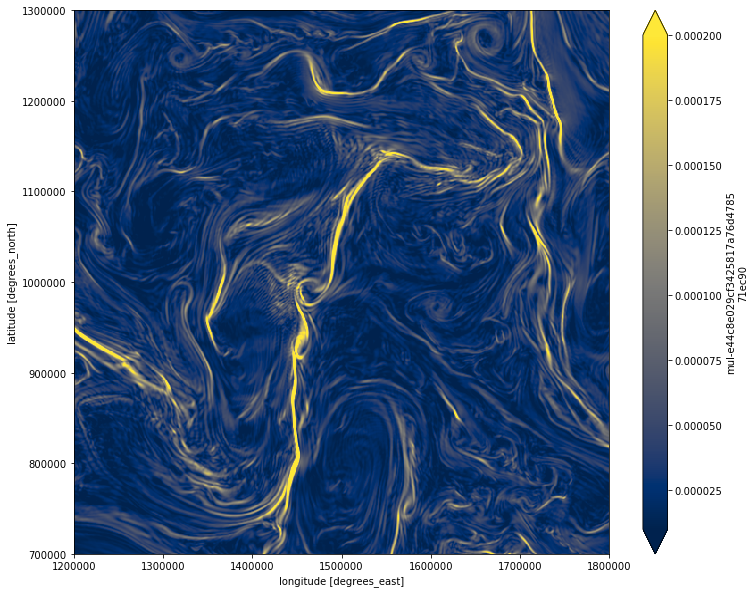

In [56]:
strain.plot(figsize=(12,10), vmin=1e-5, vmax=.2e-3, cmap='cividis')

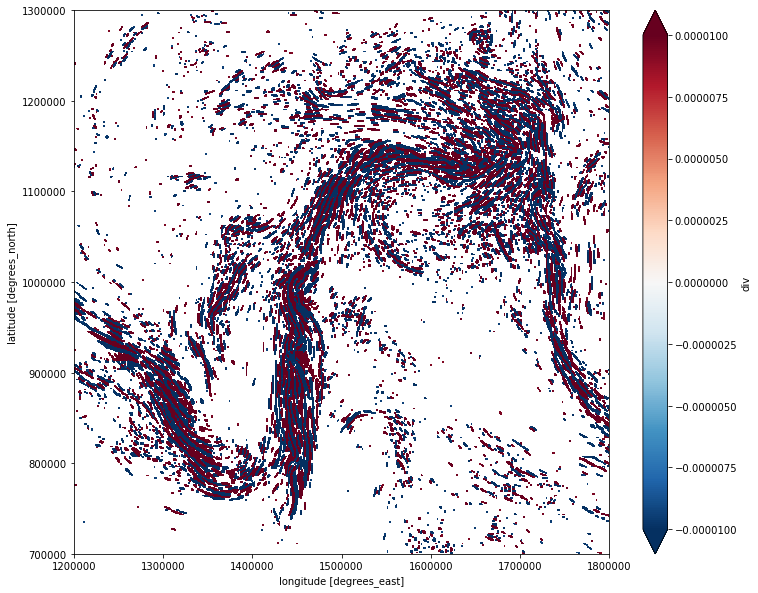

In [158]:
div400.where(np.abs(div400)>.8/86400).plot(figsize=(12,10), vmin=-.1e-4, vmax=.1e-4, cmap='RdBu_r')

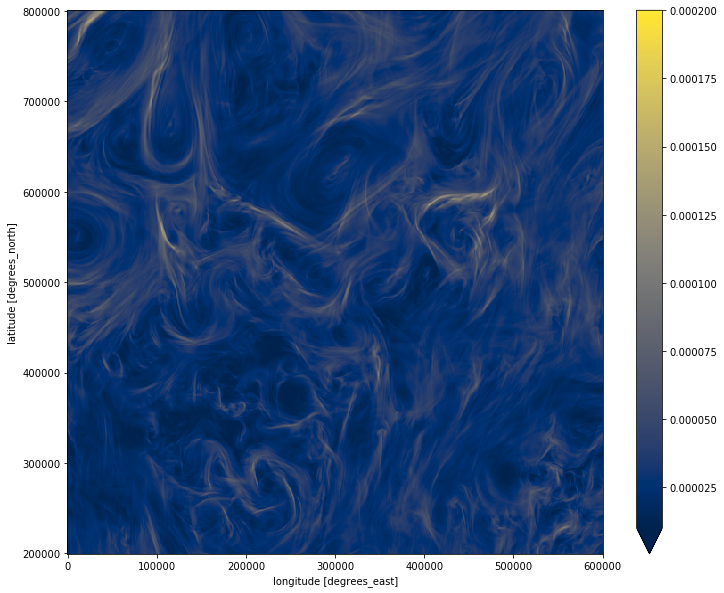

In [167]:
alpha.mean('time').plot(figsize=(12,10), vmin=1e-5, vmax=.2e-3, cmap='cividis')

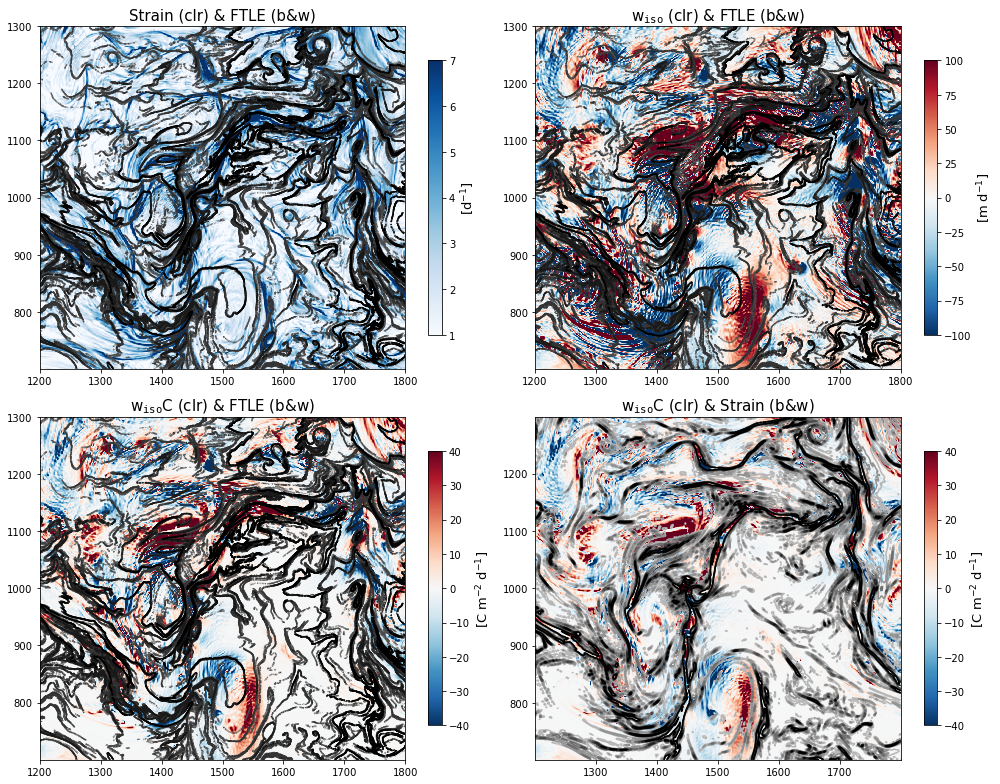

In [324]:
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(14,11))
fig.set_tight_layout(True)
# ax.pcolormesh(FTLE.x0.sel(x0=slice(None,6e5))*1e-3, FTLE.y0.sel(y0=slice(2e5,8e5))*1e-3, 
#               FTLE.ftle[1].sel(x0=slice(None,6e5),y0=slice(2e5,8e5)), vmin=0.1, vmax=1.4)
im1 = axes[0,0].pcolormesh(strain.XC*1e-3, strain.YC*1e-3, strain*86400, 
                          vmin=1, vmax=7, cmap='Blues', rasterized=True)
# cs1 = axes[0,0].contour(ftle05.XG*1e-3, ftle05.YG*1e-3,
#                        ftle05.where((ftle05<=FTLE.ftle[0].max()) & (ftle05>=1.)), 
#                        levels=np.linspace(1,1.6,8), extend='both', cmap='binary')
cs1 = axes[0,0].contour(fFTLE.x0.sel(x0=slice(12e5,18e5))*1e-3, fFTLE.y0.sel(y0=slice(7e5,13e5))*1e-3,
                      fFTLE.ftle[1].sel(y0=slice(7e5,13e5),x0=slice(12e5,18e5)).where(fFTLE.ftle[1]>=.9), 
                      levels=np.linspace(.1,1.4,11), extend='both', cmap='binary')
for c in cs1.collections:
    c.set_rasterized(True)

im2 = axes[0,1].pcolormesh(dsnap.XC.sel(XC=slice(12e5,18e5))*1e-3, dsnap.YC.sel(YC=slice(7e5,13e5))*1e-3, 
                          wiso400.sel(XC=slice(12e5,18e5),YC=slice(7e5,13e5))*86400, 
                          cmap='RdBu_r', rasterized=True,
                          vmin=-1e2, vmax=1e2
#                           norm=clr.SymLogNorm(0.01, vmin=-5e0, vmax=5e0)
                          )
# im = ax.pcolormesh(ds.XC.sel(XC=slice(2e5,8e5))*1e-3, ds.YC.sel(YC=slice(7e5,13e5))*1e-3, 
#                   np.abs(ds.W[0,36].sel(XC=slice(2e5,8e5),YC=slice(7e5,13e5)))*86400, 
#                   vmin=1, vmax=40, cmap='Reds')
# cs2 = axes[0,1].contour(ftle05.XG*1e-3, ftle05.YG*1e-3,
#                        ftle05.where((ftle05<=FTLE.ftle[0].max()) & (ftle05>=1.)), 
#                        levels=np.linspace(1,1.6,8), extend='both', cmap='binary')
cs2 = axes[0,1].contour(fFTLE.x0.sel(x0=slice(12e5,18e5))*1e-3, fFTLE.y0.sel(y0=slice(7e5,13e5))*1e-3,
                       fFTLE.ftle[1].sel(y0=slice(7e5,13e5),x0=slice(12e5,18e5)).where(fFTLE.ftle[1]>=.9), 
                       levels=np.linspace(.1,1.4,11), extend='both', cmap='binary')
for c in cs2.collections:
    c.set_rasterized(True)

im3 = axes[1,0].pcolormesh(wisoC400.XC*1e-3, wisoC400.YC*1e-3, wisoC400*86400, 
                          cmap='RdBu_r', rasterized=True,
                          vmin=-40, vmax=40
#                           norm=clr.SymLogNorm(0.01, vmin=-5e0, vmax=5e0)
                          )
# im = ax.pcolormesh(wc.XG*1e-3, wc.YG*1e-3, np.abs(wc[0]*86400), 
#                   vmin=0, vmax=10, cmap='Reds')
# cs3 = axes[1,0].contour(ftle05.XG*1e-3, ftle05.YG*1e-3,
#                        ftle05.where((ftle05<=FTLE.ftle[0].max()) & (ftle05>=1.)), 
#                        levels=np.linspace(1,1.6,8), extend='both', cmap='binary')
cs3 = axes[1,0].contour(fFTLE.x0.sel(x0=slice(12e5,18e5))*1e-3, fFTLE.y0.sel(y0=slice(7e5,13e5))*1e-3,
                       fFTLE.ftle[1].sel(y0=slice(7e5,13e5),x0=slice(12e5,18e5)).where(fFTLE.ftle[1]>=.9), 
                       levels=np.linspace(.1,1.4,11), extend='both', cmap='binary')
for c in cs3.collections:
    c.set_rasterized(True)
    
im4 = axes[1,1].pcolormesh(wisoC400.XC*1e-3, wisoC400.YC*1e-3, wisoC400*86400, 
                          cmap='RdBu_r', rasterized=True,
                          vmin=-40, vmax=40
#                           norm=clr.SymLogNorm(0.01, vmin=-5e0, vmax=5e0)
                          )
# im = ax.pcolormesh(wc.XG*1e-3, wc.YG*1e-3, np.abs(wc[0]*86400), 
#                   vmin=0, vmax=10, cmap='Reds')
cs4 = axes[1,1].contour(strain.XC*1e-3, strain.YC*1e-3,
                       (strain*86400).where(strain*86400>=2.), 
                       levels=np.linspace(1,8,8), extend='both', cmap='binary')
for c in cs4.collections:
    c.set_rasterized(True)

axes[0,0].set_title(r"Strain (clr) & FTLE (b&w)", fontsize=15)
axes[0,1].set_title(r"w$_{\tt iso}$ (clr) & FTLE (b&w)", fontsize=15)
axes[1,0].set_title(r"w$_{\tt iso}$C (clr) & FTLE (b&w)", fontsize=15)
axes[1,1].set_title(r"w$_{\tt iso}$C (clr) & Strain (b&w)", fontsize=15)
cbar1 = fig.colorbar(im1, ax=axes[0,0], shrink=.8)
cbar2 = fig.colorbar(im2, ax=axes[0,1], shrink=.8)
cbar3 = fig.colorbar(im3, ax=axes[1,0], shrink=.8)
cbar4 = fig.colorbar(im4, ax=axes[1,1], shrink=.8)
cbar1.set_label(r"[d$^{-1}$]", fontsize=13)
cbar2.set_label(r"[m d$^{-1}$]", fontsize=13)
cbar3.set_label(r"[C m$^{-2}$ d$^{-1}$]", fontsize=13)
cbar4.set_label(r"[C m$^{-2}$ d$^{-1}$]", fontsize=13)
plt.savefig(op.join(ddir,'Figures/Comp-strain-Forward10D_wisoC_z400_y700-1300_x1200-1800.pdf'))

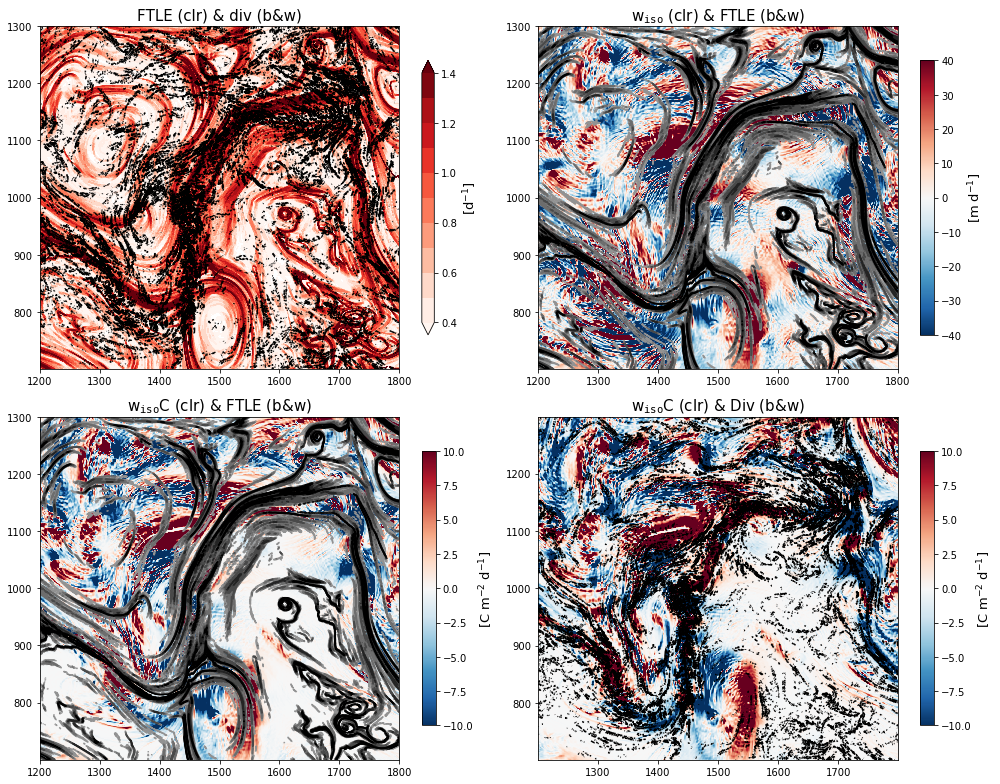

In [132]:
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(14,11))
fig.set_tight_layout(True)
# ax.pcolormesh(FTLE.x0.sel(x0=slice(None,6e5))*1e-3, FTLE.y0.sel(y0=slice(2e5,8e5))*1e-3, 
#               FTLE.ftle[1].sel(x0=slice(None,6e5),y0=slice(2e5,8e5)), vmin=0.1, vmax=1.4)
# cs1 = axes[0,0].contour(ftle05.XG*1e-3, ftle05.YG*1e-3,
#                        ftle05.where((ftle05<=FTLE.ftle[0].max()) & (ftle05>=1.)), 
#                        levels=np.linspace(1,1.6,8), extend='both', cmap='binary')
cs1 = axes[0,0].contourf(bFTLE.x0.sel(x0=slice(12e5,18e5))*1e-3, bFTLE.y0.sel(y0=slice(7e5,13e5))*1e-3,
                        bFTLE.ftle[0].sel(y0=slice(7e5,13e5),x0=slice(12e5,18e5)), 
                        levels=np.linspace(.4,1.4,11), extend='both', cmap='Reds')
im1 = axes[0,0].contour(div400.XC*1e-3, div.YC*1e-3,
                       (div400*86400).where(np.abs(div*86400)>=.9), 
                       levels=np.linspace(-1.6,1.6,8), extend='both', colors='k')
for c in cs1.collections:
    c.set_rasterized(True)
for c in im1.collections:
    c.set_rasterized(True)    

im2 = axes[0,1].pcolormesh(dsnap.XC.sel(XC=slice(12e5,18e5))*1e-3, dsnap.YC.sel(YC=slice(7e5,13e5))*1e-3, 
                          wiso400.sel(XC=slice(12e5,18e5),YC=slice(7e5,13e5))*86400, 
                          vmin=-40., vmax=40., cmap='RdBu_r', rasterized=True)
# im = ax.pcolormesh(ds.XC.sel(XC=slice(2e5,8e5))*1e-3, ds.YC.sel(YC=slice(7e5,13e5))*1e-3, 
#                   np.abs(ds.W[0,36].sel(XC=slice(2e5,8e5),YC=slice(7e5,13e5)))*86400, 
#                   vmin=1, vmax=40, cmap='Reds')
# cs2 = axes[0,1].contour(ftle05.XG*1e-3, ftle05.YG*1e-3,
#                        ftle05.where((ftle05<=FTLE.ftle[0].max()) & (ftle05>=1.)), 
#                        levels=np.linspace(1,1.6,8), extend='both', cmap='binary')
cs2 = axes[0,1].contour(bFTLE.x0.sel(x0=slice(12e5,18e5))*1e-3, bFTLE.y0.sel(y0=slice(7e5,13e5))*1e-3,
                       bFTLE.ftle[0].sel(y0=slice(7e5,13e5),x0=slice(12e5,18e5)).where(bFTLE.ftle[0]>=.7), 
                       levels=np.linspace(.4,1.4,8), extend='both', cmap='binary')
for c in cs2.collections:
    c.set_rasterized(True)

im3 = axes[1,0].pcolormesh(wisoC400.XC*1e-3, wisoC400.YC*1e-3, wisoC400*86400, 
                          vmin=-1e1, vmax=1e1, cmap='RdBu_r', rasterized=True)
# im = ax.pcolormesh(wc.XG*1e-3, wc.YG*1e-3, np.abs(wc[0]*86400), 
#                   vmin=0, vmax=10, cmap='Reds')
# cs3 = axes[1,0].contour(ftle05.XG*1e-3, ftle05.YG*1e-3,
#                        ftle05.where((ftle05<=FTLE.ftle[0].max()) & (ftle05>=1.)), 
#                        levels=np.linspace(1,1.6,8), extend='both', cmap='binary')
cs3 = axes[1,0].contour(bFTLE.x0.sel(x0=slice(12e5,18e5))*1e-3, bFTLE.y0.sel(y0=slice(7e5,13e5))*1e-3,
                       bFTLE.ftle[0].sel(y0=slice(7e5,13e5),x0=slice(12e5,18e5)).where(bFTLE.ftle[0]>=.7), 
                       levels=np.linspace(.4,1.4,8), extend='both', cmap='binary')
for c in cs3.collections:
    c.set_rasterized(True)
    
im4 = axes[1,1].pcolormesh(wisoC400.XC*1e-3, wisoC400.YC*1e-3, wisoC400*86400, 
                          vmin=-1e1, vmax=1e1, cmap='RdBu_r', rasterized=True)
# im = ax.pcolormesh(wc.XG*1e-3, wc.YG*1e-3, np.abs(wc[0]*86400), 
#                   vmin=0, vmax=10, cmap='Reds')
cs4 = axes[1,1].contour(div400.XC*1e-3, div.YC*1e-3,
                       (div400*86400).where(np.abs(div*86400)>=1.), 
                       levels=np.linspace(-1.6,1.6,8), extend='both', colors='k')
for c in cs4.collections:
    c.set_rasterized(True)

axes[0,0].set_title(r"FTLE (clr) & div (b&w)", fontsize=15)
axes[0,1].set_title(r"w$_{\tt iso}$ (clr) & FTLE (b&w)", fontsize=15)
axes[1,0].set_title(r"w$_{\tt iso}$C (clr) & FTLE (b&w)", fontsize=15)
axes[1,1].set_title(r"w$_{\tt iso}$C (clr) & Div (b&w)", fontsize=15)
cbar1 = fig.colorbar(cs1, ax=axes[0,0], shrink=.8)
cbar2 = fig.colorbar(im2, ax=axes[0,1], shrink=.8)
cbar3 = fig.colorbar(im3, ax=axes[1,0], shrink=.8)
cbar4 = fig.colorbar(im4, ax=axes[1,1], shrink=.8)
cbar1.set_label(r"[d$^{-1}$]", fontsize=13) 
cbar2.set_label(r"[m d$^{-1}$]", fontsize=13)
cbar3.set_label(r"[C m$^{-2}$ d$^{-1}$]", fontsize=13)
cbar4.set_label(r"[C m$^{-2}$ d$^{-1}$]", fontsize=13)
plt.savefig(op.join(ddir,'Figures/Comp-div-Backward_wisoC_z400_y700-1300_x1200-1800.pdf'))

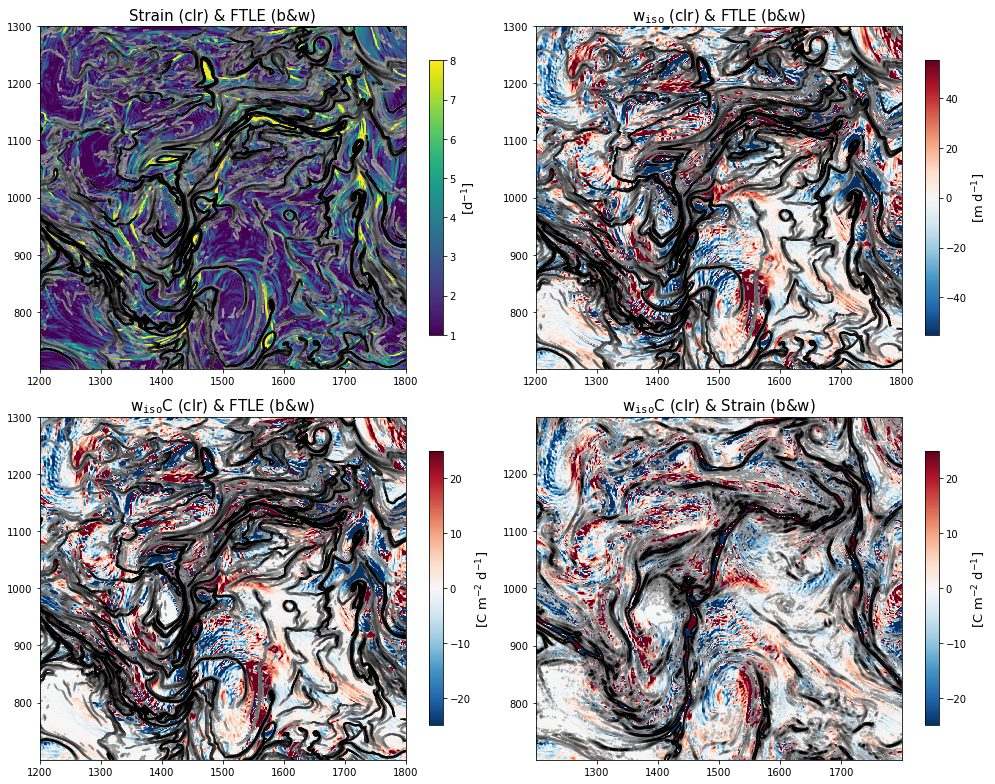

In [196]:
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(14,11))
fig.set_tight_layout(True)
# ax.pcolormesh(FTLE.x0.sel(x0=slice(None,6e5))*1e-3, FTLE.y0.sel(y0=slice(2e5,8e5))*1e-3, 
#               FTLE.ftle[1].sel(x0=slice(None,6e5),y0=slice(2e5,8e5)), vmin=0.1, vmax=1.4)
im1 = axes[0,0].pcolormesh(strain.XC*1e-3, strain.YC*1e-3, strain*86400, 
                          vmin=1, vmax=8, cmap='viridis', rasterized=True)
# cs1 = axes[0,0].contour(ftle05.XG*1e-3, ftle05.YG*1e-3,
#                        ftle05.where((ftle05<=FTLE.ftle[0].max()) & (ftle05>=1.)), 
#                        levels=np.linspace(1,1.6,8), extend='both', cmap='binary')
cs1 = axes[0,0].contour(fFTLE.x0.sel(x0=slice(12e5,18e5))*1e-3, fFTLE.y0.sel(y0=slice(7e5,13e5))*1e-3,
                      fFTLE.ftle[0].sel(y0=slice(7e5,13e5),x0=slice(12e5,18e5)).where(fFTLE.ftle[0]>=.95), 
                      levels=np.linspace(.4,2.,11), extend='both', cmap='binary')
for c in cs1.collections:
    c.set_rasterized(True)

im2 = axes[0,1].pcolormesh(dsnap.XC.sel(XC=slice(12e5,18e5))*1e-3, dsnap.YC.sel(YC=slice(7e5,13e5))*1e-3, 
                          wiso200.sel(XC=slice(12e5,18e5),YC=slice(7e5,13e5))*86400, 
                          vmin=-55., vmax=55., cmap='RdBu_r', rasterized=True)
# im = ax.pcolormesh(ds.XC.sel(XC=slice(2e5,8e5))*1e-3, ds.YC.sel(YC=slice(7e5,13e5))*1e-3, 
#                   np.abs(ds.W[0,36].sel(XC=slice(2e5,8e5),YC=slice(7e5,13e5)))*86400, 
#                   vmin=1, vmax=40, cmap='Reds')
# cs2 = axes[0,1].contour(ftle05.XG*1e-3, ftle05.YG*1e-3,
#                        ftle05.where((ftle05<=FTLE.ftle[0].max()) & (ftle05>=1.)), 
#                        levels=np.linspace(1,1.6,8), extend='both', cmap='binary')
cs2 = axes[0,1].contour(fFTLE.x0.sel(x0=slice(12e5,18e5))*1e-3, fFTLE.y0.sel(y0=slice(7e5,13e5))*1e-3,
                      fFTLE.ftle[0].sel(y0=slice(7e5,13e5),x0=slice(12e5,18e5)).where(fFTLE.ftle[0]>=.95), 
                      levels=np.linspace(.4,2.,11), extend='both', cmap='binary')
for c in cs2.collections:
    c.set_rasterized(True)

im3 = axes[1,0].pcolormesh(wisoC200.XC*1e-3, wisoC200.YC*1e-3, wisoC200*86400, 
                          vmin=-2.5e1, vmax=2.5e1, cmap='RdBu_r', rasterized=True)
# im = ax.pcolormesh(wc.XG*1e-3, wc.YG*1e-3, np.abs(wc[0]*86400), 
#                   vmin=0, vmax=10, cmap='Reds')
# cs3 = axes[1,0].contour(ftle05.XG*1e-3, ftle05.YG*1e-3,
#                        ftle05.where((ftle05<=FTLE.ftle[0].max()) & (ftle05>=1.)), 
#                        levels=np.linspace(1,1.6,8), extend='both', cmap='binary')
cs3 = axes[1,0].contour(fFTLE.x0.sel(x0=slice(12e5,18e5))*1e-3, fFTLE.y0.sel(y0=slice(7e5,13e5))*1e-3,
                       fFTLE.ftle[0].sel(y0=slice(7e5,13e5),x0=slice(12e5,18e5)).where(fFTLE.ftle[0]>=.95), 
                       levels=np.linspace(.4,2.,11), extend='both', cmap='binary')
for c in cs3.collections:
    c.set_rasterized(True)
    
im4 = axes[1,1].pcolormesh(wisoC200.XC*1e-3, wisoC200.YC*1e-3, wisoC200*86400, 
                          vmin=-2.5e1, vmax=2.5e1, cmap='RdBu_r', rasterized=True)
# im = ax.pcolormesh(wc.XG*1e-3, wc.YG*1e-3, np.abs(wc[0]*86400), 
#                   vmin=0, vmax=10, cmap='Reds')
cs4 = axes[1,1].contour(strain.XC*1e-3, strain.YC*1e-3,
                       (strain*86400).where(strain*86400>=2.), 
                       levels=np.linspace(0,8,8), extend='both', cmap='binary')
for c in cs4.collections:
    c.set_rasterized(True)

axes[0,0].set_title(r"Strain (clr) & FTLE (b&w)", fontsize=15)
axes[0,1].set_title(r"w$_{\tt iso}$ (clr) & FTLE (b&w)", fontsize=15)
axes[1,0].set_title(r"w$_{\tt iso}$C (clr) & FTLE (b&w)", fontsize=15)
axes[1,1].set_title(r"w$_{\tt iso}$C (clr) & Strain (b&w)", fontsize=15)
cbar1 = fig.colorbar(im1, ax=axes[0,0], shrink=.8)
cbar2 = fig.colorbar(im2, ax=axes[0,1], shrink=.8)
cbar3 = fig.colorbar(im3, ax=axes[1,0], shrink=.8)
cbar4 = fig.colorbar(im4, ax=axes[1,1], shrink=.8)
cbar1.set_label(r"[d$^{-1}$]", fontsize=13)
cbar2.set_label(r"[m d$^{-1}$]", fontsize=13)
cbar3.set_label(r"[C m$^{-2}$ d$^{-1}$]", fontsize=13)
cbar4.set_label(r"[C m$^{-2}$ d$^{-1}$]", fontsize=13)
plt.savefig(op.join(ddir,'Figures/Comp-strain-Forward_wisoC_z200_y700-1300_x1200-1800.pdf'))

/home/takaya/.conda/envs/ftle2/lib/python3.6/site-packages/xarray/core/nanops.py:161: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


(700, 1300)

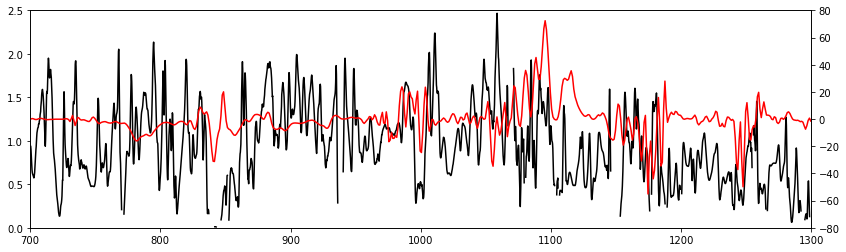

In [233]:
fig, ax = plt.subplots(figsize=(14,4))
ax2 = ax.twinx()
ax.plot(fFTLE.y0.sel(y0=slice(7e5,13e5))*1e-3, 
        fFTLE.ftle[0].sel(y0=slice(7e5,13e5),
                          x0=slice(14.3e5-5e2,14.3e5+5e2)
                         ).mean('x0').rolling(y0=5, center=True).mean(), 
        'k')
# ax2.plot(wisoC200.YC.sel(YC=slice(7e5,13e5))*1e-3, 
#          wisoC200.sel(YC=slice(7e5,13e5)).sel(XC=14.3e5, method='nearest')*86400,
#         'r')
ax2.plot(wisoC400.YC.sel(YC=slice(7e5,13e5))*1e-3, 
         wisoC400.sel(YC=slice(7e5,13e5)).sel(XC=14.3e5, method='nearest')*86400,
        'r')
ax.set_ylim([0,2.5])
ax2.set_ylim([-80,80])
ax.set_xlim([700,1300])

/home/takaya/.conda/envs/ftle2/lib/python3.6/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in true_divide
  return func(*args2)
/home/takaya/.conda/envs/ftle2/lib/python3.6/site-packages/dask/core.py:119: RuntimeWarning: divide by zero encountered in true_divide
  return func(*args2)
/home/takaya/.conda/envs/ftle2/lib/python3.6/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in add
  return func(*args2)
/home/takaya/.conda/envs/ftle2/lib/python3.6/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in true_divide
  return func(*args2)
/home/takaya/.conda/envs/ftle2/lib/python3.6/site-packages/dask/core.py:119: RuntimeWarning: divide by zero encountered in true_divide
  return func(*args2)
/home/takaya/.conda/envs/ftle2/lib/python3.6/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in add
  return func(*args2)


(-100, 100)

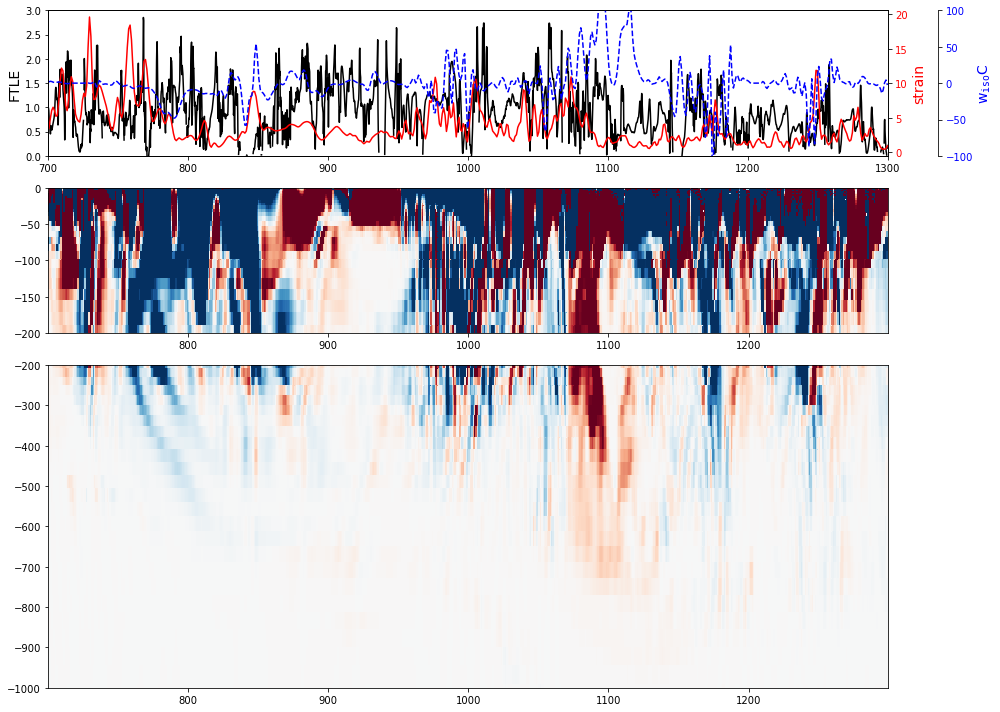

In [302]:
fig = plt.figure(figsize=(14,10))
fig.set_tight_layout(True)
GS = gs.GridSpec(4,2)
ax1 = fig.add_subplot(GS[0,:])
ax2 = ax1.twinx()
ax5 = ax1.twinx()
ax5.spines["right"].set_position(("axes", 1.06))
ax3 = fig.add_subplot(GS[1:2,:])
ax4 = fig.add_subplot(GS[2:,:])

ax1.plot(fFTLE.y0.sel(y0=slice(7e5,13e5))*1e-3, 
         fFTLE.ftle[0].sel(y0=slice(7e5,13e5)).sel(x0=14.3e5, method='nearest'), 'k')
ax2.plot(strain.YC.sel(YC=slice(7e5,13e5))*1e-3, 
         strain.sel(YC=slice(7e5,13e5)).sel(XC=14.3e5, method='nearest')*86400, 'r')
# ax5.plot(wisoC200.YC.sel(YC=slice(7e5,13e5))*1e-3, 
#          wisoC200.sel(YC=slice(7e5,13e5)).sel(XC=14.3e5, method='nearest')*86400,
#         'b')
ax5.plot(wisoC400.YC.sel(YC=slice(7e5,13e5))*1e-3, 
         wisoC400.sel(YC=slice(7e5,13e5)).sel(XC=14.3e5, method='nearest')*86400,
        'b--')

im3 = ax3.pcolormesh(wisoC.YC.sel(YC=slice(7e5,13e5))*1e-3, wisoC.Z,
                    wisoC[nt].sel(YC=slice(7e5,13e5)).sel(XC=14.3e5, method='nearest')*86400,
                    vmax=2e2, vmin=-2e2, cmap='RdBu_r', rasterized=True)
ax4.pcolormesh(wisoC.YC.sel(YC=slice(7e5,13e5))*1e-3, wisoC.Z,
              wisoC[nt].sel(YC=slice(7e5,13e5)).sel(XC=14.3e5, method='nearest')*86400,
              vmax=2e2, vmin=-2e2, cmap='RdBu_r', rasterized=True)

ax1.set_xlim([700,1300])
ax1.set_ylim([0,3])
ax2.tick_params(axis='y', labelcolor='r')
ax5.tick_params(axis='y', labelcolor='b')
ax1.set_ylabel(r"FTLE", fontsize=14)
ax2.set_ylabel(r"strain", color='r', fontsize=14)
ax5.set_ylabel(r"w$_{\tt iso}$C", color='b', fontsize=14)
# ax3.set_xlim([700,1300])
ax3.set_ylim([-200,0])
ax4.set_ylim([-1000,-200])
ax5.set_ylim([-100,100])
# fig.colorbar()

In [75]:
def nan_helper(y):
    """Helper to handle indices and logical indices of NaNs.

    Input:
        - y, 1d numpy array with possible NaNs
    Output:
        - nans, logical indices of NaNs
        - index, a function, with signature indices= index(logical_indices),
          to convert logical indices of NaNs to 'equivalent' indices
    Example:
        >>> # linear interpolation of NaNs
        >>> nans, x= nan_helper(y)
        >>> y[nans]= np.interp(x(nans), x(~nans), y[~nans])
    """

    return np.isnan(y), lambda z: z.nonzero()[0]

In [140]:
nans, xs = nan_helper(bFTLE.ftle[0].sel(x0=slice(12e5,18e5),y0=slice(7e5,13e5)).data)
print(nans,xs)

xx, yy = np.meshgrid(bFTLE.x0.sel(x0=slice(12e5,18e5)).data, bFTLE.y0.sel(y0=slice(7e5,13e5)).data)
x1 = xx[~nans]
y1 = yy[~nans]
x2, y2 = np.meshgrid(dsnap.XC.sel(XC=slice(12e5,18e5)).data,dsnap.YC.sel(YC=slice(7e5,13e5)).data)
# func = naiso.interp2d(FTLE.x0.data, FTLE.y0.data, FTLE.ftle[1].data[~nans], 
#                       kind='cubic', fill_value=np.nan)
# ftle10 = xr.DataArray(func(ds.XG.data, ds.YG.data), dims=alpha.dims, coords=alpha.coords)
npar = naiso.griddata((x1,y1), bFTLE.ftle[0].sel(x0=slice(12e5,18e5),y0=slice(7e5,13e5)).data[~nans], 
                     (x2,y2), method='cubic')
bftle05 = xr.DataArray(npar, dims=['YC','XC'], 
                      coords={'YC':dsnap.YC.sel(YC=slice(7e5,13e5)).data,
                             'XC':dsnap.XC.sel(XC=slice(12e5,18e5)).data})

[[False False False ... False False False]
 [False False False ... False False False]
 [False False False ... False False False]
 ...
 [ True False False ... False False False]
 [ True  True False ... False False False]
 [ True False False ... False False False]] <function nan_helper.<locals>.<lambda> at 0x7f274516bbf8>


In [141]:
nans, xs = nan_helper(fFTLE.ftle[0].sel(x0=slice(12e5,18e5),y0=slice(7e5,13e5)).data)
print(nans,xs)

xx, yy = np.meshgrid(fFTLE.x0.sel(x0=slice(12e5,18e5)).data, fFTLE.y0.sel(y0=slice(7e5,13e5)).data)
x1 = xx[~nans]
y1 = yy[~nans]
x2, y2 = np.meshgrid(dsnap.XC.sel(XC=slice(12e5,18e5)).data,dsnap.YC.sel(YC=slice(7e5,13e5)).data)
# func = naiso.interp2d(FTLE.x0.data, FTLE.y0.data, FTLE.ftle[1].data[~nans], 
#                       kind='cubic', fill_value=np.nan)
# ftle10 = xr.DataArray(func(ds.XG.data, ds.YG.data), dims=alpha.dims, coords=alpha.coords)
npar = naiso.griddata((x1,y1), fFTLE.ftle[0].sel(x0=slice(12e5,18e5),y0=slice(7e5,13e5)).data[~nans], 
                     (x2,y2), method='cubic')
fftle05 = xr.DataArray(npar, dims=['YC','XC'], 
                      coords={'YC':dsnap.YC.sel(YC=slice(7e5,13e5)).data,
                             'XC':dsnap.XC.sel(XC=slice(12e5,18e5)).data})

[[False False False ... False False False]
 [False False False ... False False False]
 [False False False ... False False False]
 ...
 [False False False ... False False False]
 [False False False ... False False False]
 [False False False ... False False False]] <function nan_helper.<locals>.<lambda> at 0x7f27d1105ae8>


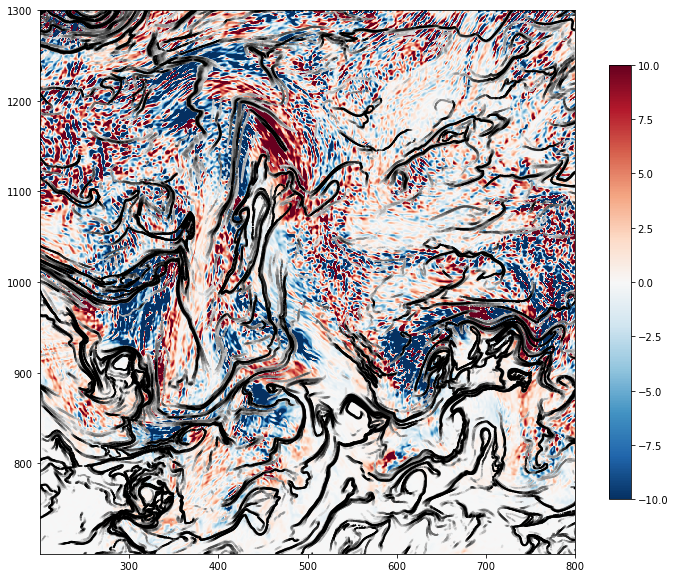

In [414]:
ftle05 = xr.DataArray(npar, dims=alpha[0].dims, coords=alpha[0].coords)

fig, ax = plt.subplots(figsize=(12,10))
# ax.pcolormesh(FTLE.x0.sel(x0=slice(None,6e5))*1e-3, FTLE.y0.sel(y0=slice(2e5,8e5))*1e-3, 
#               FTLE.ftle[1].sel(x0=slice(None,6e5),y0=slice(2e5,8e5)), vmin=0.1, vmax=1.4)
im = ax.pcolormesh(wc400.XG*1e-3, wc400.YG*1e-3, wc400[0]*86400, 
                  vmin=-10, vmax=10, cmap='RdBu_r')
# im = ax.pcolormesh(wc.XG*1e-3, wc.YG*1e-3, np.abs(wc[0]*86400), 
#                   vmin=0, vmax=10, cmap='Reds')
# cs = ax.contour(ftle05.XG*1e-3, ftle05.YG*1e-3,
#               ftle05.where((ftle05<=FTLE.ftle[0].max()) & (ftle05>=1.)), 
#               levels=np.linspace(1,1.6,8), extend='both', cmap='binary')
cs = ax.contour(fFTLE.x0.sel(x0=slice(2e5,8e5))*1e-3, fFTLE.y0.sel(y0=slice(7e5,13e5))*1e-3,
              fFTLE.ftle[0].sel(y0=slice(7e5,13e5),x0=slice(2e5,8e5)).where(fFTLE.ftle[0]>=1.), 
              levels=np.linspace(1,1.6,8), extend='both', cmap='binary')
for c in cs.collections:
    c.set_rasterized(True)
fig.colorbar(im, ax=ax, shrink=.8)

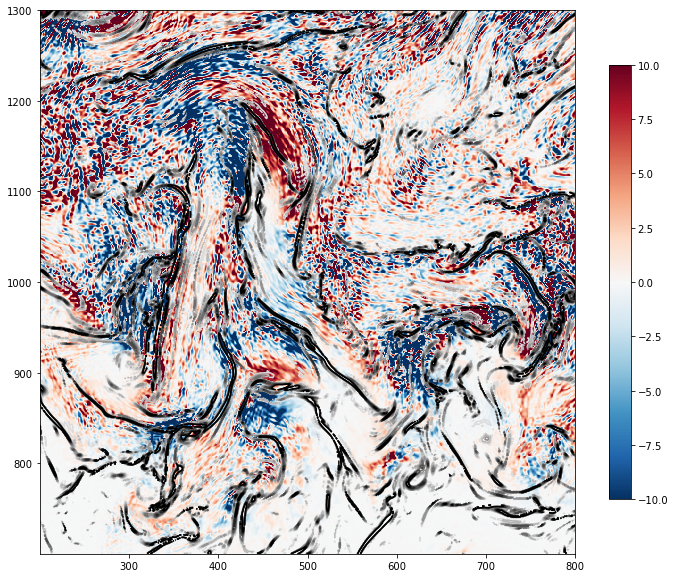

In [325]:
fig, ax = plt.subplots(figsize=(12,10))
# ax.pcolormesh(FTLE.x0.sel(x0=slice(None,6e5))*1e-3, FTLE.y0.sel(y0=slice(2e5,8e5))*1e-3, 
#               FTLE.ftle[1].sel(x0=slice(None,6e5),y0=slice(2e5,8e5)), vmin=0.1, vmax=1.4)
im = ax.pcolormesh(wc.XG*1e-3, wc.YG*1e-3, wc[0]*86400, 
                  vmin=-10, vmax=10, cmap='RdBu_r')
# im = ax.pcolormesh(wc.XG*1e-3, wc.YG*1e-3, np.abs(wc[0]*86400), 
#                   vmin=0, vmax=10, cmap='Reds')
cs = ax.contour(alpha.XG*1e-3, alpha.YG*1e-3,
               (alpha[0]*86400).where(alpha[0]*86400>=3.), 
               levels=np.linspace(3,8,8), extend='both', cmap='binary')
for c in cs.collections:
    c.set_rasterized(True)
fig.colorbar(im, ax=ax, shrink=.8)

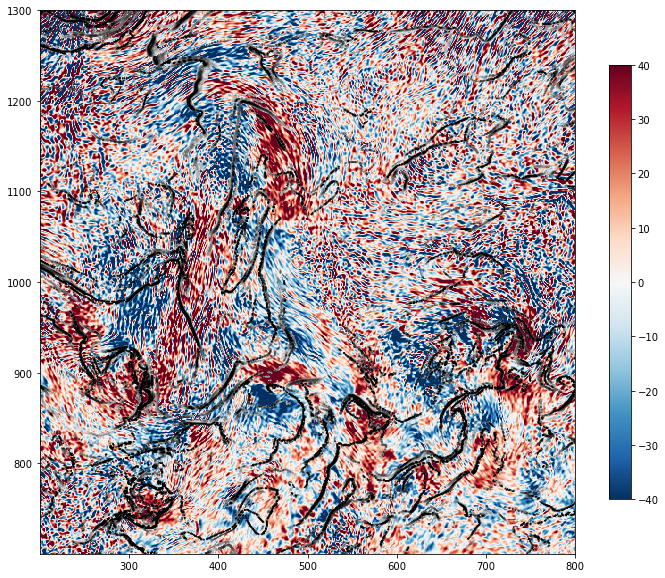

In [333]:
ftle05 = xr.DataArray(npar, dims=alpha[0].dims, coords=alpha[0].coords)

fig, ax = plt.subplots(figsize=(12,10))
# ax.pcolormesh(FTLE.x0.sel(x0=slice(None,6e5))*1e-3, FTLE.y0.sel(y0=slice(2e5,8e5))*1e-3, 
#               FTLE.ftle[1].sel(x0=slice(None,6e5),y0=slice(2e5,8e5)), vmin=0.1, vmax=1.4)
im = ax.pcolormesh(ds.XC.sel(XC=slice(2e5,8e5))*1e-3, ds.YC.sel(YC=slice(7e5,13e5))*1e-3, 
                  ds.W[0,36].sel(XC=slice(2e5,8e5),YC=slice(7e5,13e5))*86400, 
                  vmin=-40, vmax=40, cmap='RdBu_r')
# im = ax.pcolormesh(ds.XC.sel(XC=slice(2e5,8e5))*1e-3, ds.YC.sel(YC=slice(7e5,13e5))*1e-3, 
#                   np.abs(ds.W[0,36].sel(XC=slice(2e5,8e5),YC=slice(7e5,13e5)))*86400, 
#                   vmin=1, vmax=40, cmap='Reds')
cs = ax.contour(ftle05.XG*1e-3, ftle05.YG*1e-3,
              ftle05.where((ftle05<=FTLE.ftle[0].max()) & (ftle05>=1.)), 
              levels=np.linspace(1,1.6,8), extend='both', cmap='binary')
for c in cs.collections:
    c.set_rasterized(True)
fig.colorbar(im, ax=ax, shrink=.8)

([array([112., 177., 156.,  84.,  29.,  10.,   3.,   1.,   0.,   0.]),
  array([133., 165., 159.,  77.,  32.,  11.,   2.,   0.,   0.,   0.]),
  array([120., 165., 147.,  91.,  31.,   3.,   4.,   0.,   0.,   0.]),
  array([100., 166., 145., 105.,  40.,   6.,   2.,   0.,   0.,   0.]),
  array([107., 165., 136.,  94.,  46.,  14.,   7.,   0.,   0.,   0.]),
  array([ 97., 158., 143., 104.,  35.,  22.,   3.,   0.,   0.,   0.]),
  array([ 86., 170., 156.,  91.,  43.,  17.,   1.,   0.,   0.,   0.]),
  array([ 98., 153., 142.,  97.,  60.,   9.,   4.,   0.,   0.,   0.]),
  array([109., 145., 177.,  74.,  43.,  18.,   2.,   0.,   0.,   0.]),
  array([119., 165., 152.,  87.,  32.,  21.,   1.,   0.,   0.,   0.]),
  array([104., 187., 145.,  92.,  32.,  12.,   4.,   0.,   0.,   0.]),
  array([ 92., 180., 164.,  86.,  26.,  15.,   3.,   0.,   0.,   0.]),
  array([101., 191., 153.,  69.,  38.,  10.,   8.,   0.,   0.,   0.]),
  array([108., 192., 152.,  70.,  26.,  10.,   5.,   0.,   0.,   0.]),
  arra

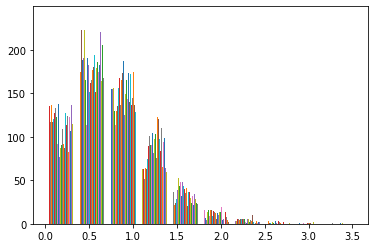

In [181]:
plt.hist(fftle05.where((fftle05<=fFTLE.ftle[0].max()) & (fftle05>0.)))

([array([  0.,   0.,   0.,   0.,   1.,   3.,   9.,  36., 313., 210.]),
  array([  0.,   0.,   0.,   0.,   2.,   1.,  18.,  55., 298., 205.]),
  array([  0.,   0.,   0.,   0.,   0.,   4.,  18.,  39., 294., 206.]),
  array([  1.,   0.,   0.,   0.,   0.,   7.,  11.,  37., 277., 231.]),
  array([  0.,   0.,   0.,   0.,   1.,   0.,  12.,  51., 284., 221.]),
  array([  0.,   0.,   0.,   0.,   1.,   3.,  15.,  45., 256., 242.]),
  array([  0.,   0.,   0.,   0.,   0.,   4.,   7.,  32., 280., 241.]),
  array([  0.,   0.,   0.,   0.,   0.,   1.,  11.,  44., 263., 244.]),
  array([  0.,   0.,   0.,   0.,   1.,   2.,   9.,  51., 275., 230.]),
  array([  0.,   0.,   0.,   0.,   0.,   3.,  13.,  46., 300., 215.]),
  array([  0.,   0.,   0.,   0.,   0.,   2.,  10.,  38., 313., 213.]),
  array([  0.,   0.,   0.,   0.,   1.,   1.,   3.,  36., 317., 208.]),
  array([  0.,   0.,   0.,   0.,   0.,   2.,   7.,  30., 327., 204.]),
  array([  0.,   0.,   0.,   1.,   0.,   3.,  12.,  40., 323., 184.]),
  arra

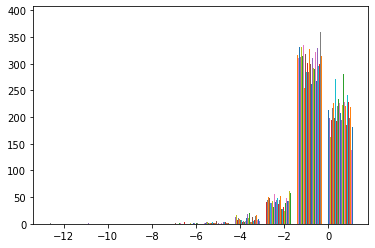

In [180]:
plt.hist(np.log(fftle05.where((fftle05<=fFTLE.ftle[0].max()) & (fftle05>0.))))

In [322]:
strain.name = 'strain'
div400.name = 'div'
bftle05.name = 'bfiveD'
fftle05.name = 'ffiveD'
wisoC400.name = 'wisoC'
wiso400.name = 'wiso'
arrspacing = np.concatenate((-np.logspace(2,-2,10)[:-1],np.linspace(-0.01,0.01,10)), axis=None)
arrspacing = np.concatenate((arrspacing,np.logspace(-2,2,10)[1:]), axis=None)

with ProgressBar():
#     hist1 = xhist(bftle05.where((bftle05<=bFTLE.ftle[0].max()) & (bftle05>0.)), 
#                  np.log(strain*86400), 
#                  bins=[np.linspace(0,1.6,30),np.linspace(-2,4,30)]
#     #              bins=[np.logspace(-2,0.2,20),np.logspace(-5.1,-3.8,30)]
#                  ).compute()
    hist2 = xhist(wisoC400*86400, 
                 np.log10(fftle05.where((fftle05<=fFTLE.ftle[0].max()) & (fftle05>0.))),
                 bins=[np.linspace(-1e2,1e2,30),np.linspace(-1,1,30)]
    #              bins=[np.logspace(-2,0.2,20),np.logspace(-5.1,-3.8,30)]
                 ).compute()
    hist3 = xhist(wisoC400*86400, 
                 np.log10(strain*86400),
                 bins=[np.linspace(-1e2,1e2,31),np.linspace(-1,1,30)]
    #              bins=[np.logspace(-2,0.2,20),np.logspace(-5.1,-3.8,30)]
                 ).compute()
    hist4 = xhist(wiso400.sel(XC=slice(12e5,18e5),YC=slice(7e5,13e5))*86400, 
                 np.log10(fftle05.where((fftle05<=fFTLE.ftle[0].max()) & (fftle05>0.))),
                 bins=[np.linspace(-1e2,1e2,30),np.linspace(-1,1,30)]
    #              bins=[np.logspace(-2,0.2,20),np.logspace(-5.1,-3.8,30)]
                 ).compute()
    hist5 = xhist(wisoC400*86400, 
                 div400.where(np.abs(div400)>(.1/86400))*86400,
                 bins=[np.linspace(-1e2,1e2,31),np.linspace(-1.6,1.6,30)]
    #              bins=[np.logspace(-2,0.2,20),np.logspace(-5.1,-3.8,30)]
                 ).compute()
#     hist6 = xhist(bftle05.where((bftle05<=bFTLE.ftle[0].max()) & (bftle05>0.)), 
#                  div400*86400, 
#                  bins=[np.linspace(0,1.6,30),np.linspace(-1.6,1.6,30)]
#     #              bins=[np.logspace(-2,0.2,20),np.logspace(-5.1,-3.8,30)]
#                  ).compute()
    hist7 = xhist(np.log10(fftle05.where((fftle05<=fFTLE.ftle[0].max()) & (fftle05>0.))), 
                 np.log10(strain*86400), 
                 bins=[np.linspace(-1,2,30),np.linspace(-1,1,30)]
    #              bins=[np.logspace(-2,0.2,20),np.logspace(-5.1,-3.8,30)]
                 ).compute()
#     hist8 = xhist(fftle05.where((fftle05<=fFTLE.ftle[0].max()) & (fftle05>0.)), 
#                  div400*86400, 
#                  bins=[np.linspace(0,1.6,30),np.linspace(-1.6,1.6,30)]
#     #              bins=[np.logspace(-2,0.2,20),np.logspace(-5.1,-3.8,30)]
#                  ).compute()
hist3

<xarray.DataArray 'histogram_wisoC_strain' (wisoC_bin: 30, strain_bin: 29)>
array([[ 0,  0,  0, ..., 28, 12, 20],
       [ 0,  0,  0, ..., 24, 32, 22],
       [ 0,  0,  0, ..., 40, 26, 25],
       ...,
       [ 0,  0,  0, ..., 28, 23, 23],
       [ 0,  0,  0, ..., 28, 37, 17],
       [ 0,  0,  0, ..., 25, 14, 16]])
Coordinates:
  * wisoC_bin   (wisoC_bin) float64 -96.67 -90.0 -83.33 ... 83.33 90.0 96.67
  * strain_bin  (strain_bin) float64 -0.9655 -0.8966 -0.8276 ... 0.8966 0.9655

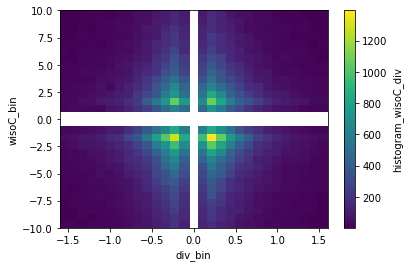

In [136]:
hist5.where(hist5>0.).plot()

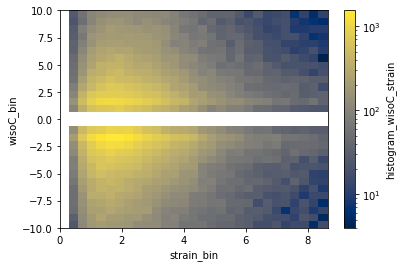

In [95]:
hist3.where(hist3>0.).plot(norm=clr.LogNorm(), cmap='cividis')

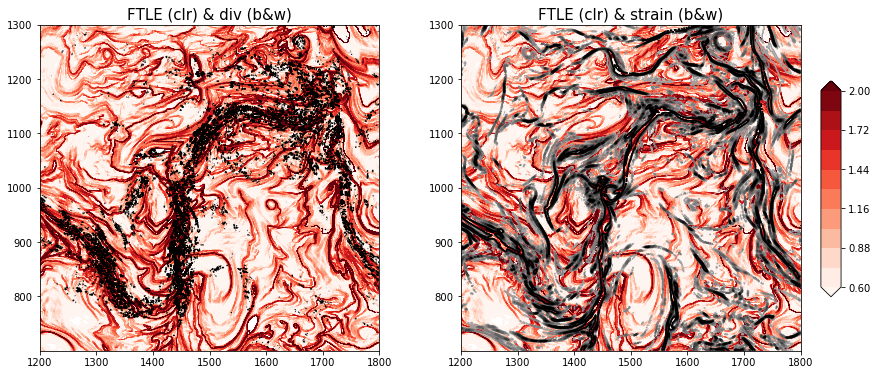

In [160]:
fig, (ax1,ax2) = plt.subplots(nrows=1, ncols=2, figsize=(14,6))
# fig.set_tight_layout(True)
cs1 = ax1.contourf(fFTLE.x0.sel(x0=slice(12e5,18e5))*1e-3, fFTLE.y0.sel(y0=slice(7e5,13e5))*1e-3,
                  fFTLE.ftle[0].sel(y0=slice(7e5,13e5),x0=slice(12e5,18e5)), 
                  levels=np.linspace(.6,2.,11), extend='both', cmap='Reds')
im1 = ax1.contour(div400.XC*1e-3, div400.YC*1e-3,
                 (div400*86400).where(np.abs(div400*86400)>=.8), 
                 levels=np.linspace(-1.6,1.6,12), extend='both', colors='k')
for c in cs1.collections:
    c.set_rasterized(True)
for c in im1.collections:
    c.set_rasterized(True)
    
cs2 = ax2.contourf(fFTLE.x0.sel(x0=slice(12e5,18e5))*1e-3, fFTLE.y0.sel(y0=slice(7e5,13e5))*1e-3,
                  fFTLE.ftle[0].sel(y0=slice(7e5,13e5),x0=slice(12e5,18e5)), 
                  levels=np.linspace(.6,2.,11), extend='both', cmap='Reds')
im2 = ax2.contour(strain.XC*1e-3, strain.YC*1e-3,
                 (strain*86400).where(strain*86400>=3.), 
                 levels=np.linspace(1,8,9), extend='both', cmap='binary')
for c in cs2.collections:
    c.set_rasterized(True)
for c in im2.collections:
    c.set_rasterized(True)
    
ax1.set_title(r"FTLE (clr) & div (b&w)", fontsize=15)
ax2.set_title(r"FTLE (clr) & strain (b&w)", fontsize=15)

fig.subplots_adjust(right=0.88, hspace=0.22, wspace=.24)
cbar_ax = fig.add_axes([0.9, 0.25, 0.02, 0.5])
cbar = fig.colorbar(cs1, cax=cbar_ax)

plt.savefig(op.join(ddir,'Figures/fFTLE_div-strain_tau05d.pdf'))

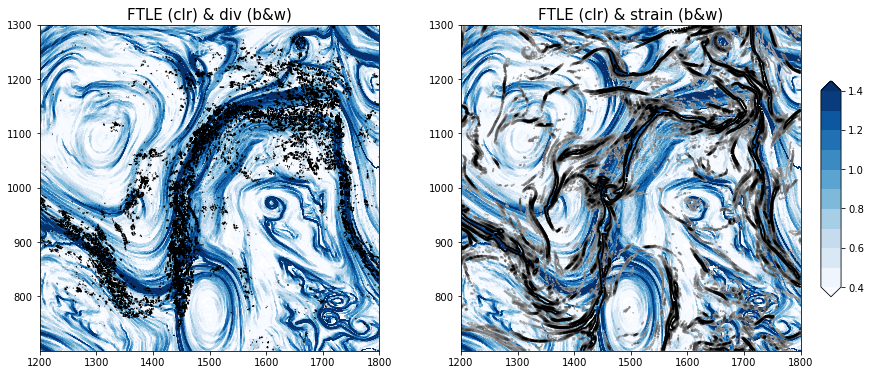

In [161]:
fig, (ax1,ax2) = plt.subplots(nrows=1, ncols=2, figsize=(14,6))
# fig.set_tight_layout(True)
cs1 = ax1.contourf(bFTLE.x0.sel(x0=slice(12e5,18e5))*1e-3, bFTLE.y0.sel(y0=slice(7e5,13e5))*1e-3,
                  bFTLE.ftle[0].sel(y0=slice(7e5,13e5),x0=slice(12e5,18e5)), 
                  levels=np.linspace(.4,1.4,11), extend='both', cmap='Blues')
im1 = ax1.contour(div400.XC*1e-3, div400.YC*1e-3,
                 (div400*86400).where(np.abs(div400*86400)>=.8), 
                 levels=np.linspace(-1.6,1.6,12), extend='both', colors='k')
for c in cs1.collections:
    c.set_rasterized(True)
for c in im1.collections:
    c.set_rasterized(True)
    
cs2 = ax2.contourf(bFTLE.x0.sel(x0=slice(12e5,18e5))*1e-3, bFTLE.y0.sel(y0=slice(7e5,13e5))*1e-3,
                  bFTLE.ftle[0].sel(y0=slice(7e5,13e5),x0=slice(12e5,18e5)), 
                  levels=np.linspace(.4,1.4,11), extend='both', cmap='Blues')
im2 = ax2.contour(strain.XC*1e-3, strain.YC*1e-3,
                 (strain*86400).where(strain*86400>=3.), 
                 levels=np.linspace(1,8,9), extend='both', cmap='binary')
for c in cs2.collections:
    c.set_rasterized(True)
for c in im2.collections:
    c.set_rasterized(True)
    
ax1.set_title(r"FTLE (clr) & div (b&w)", fontsize=15)
ax2.set_title(r"FTLE (clr) & strain (b&w)", fontsize=15)

fig.subplots_adjust(right=0.88, hspace=0.22, wspace=.24)
cbar_ax = fig.add_axes([0.9, 0.25, 0.02, 0.5])
cbar = fig.colorbar(cs1, cax=cbar_ax)

plt.savefig(op.join(ddir,'Figures/bFTLE_div-strain_tau05d.pdf'))

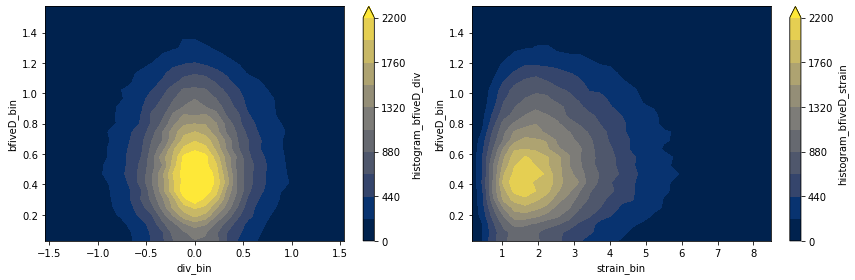

In [149]:
fig, (ax1,ax2) = plt.subplots(nrows=1, ncols=2, figsize=(12,4))
fig.set_tight_layout(True)
hist6.plot.contourf(ax=ax1, cmap='cividis', levels=np.linspace(0,2200,11), extend='max')
hist1.plot.contourf(ax=ax2, cmap='cividis', levels=np.linspace(0,2200,11), extend='max')

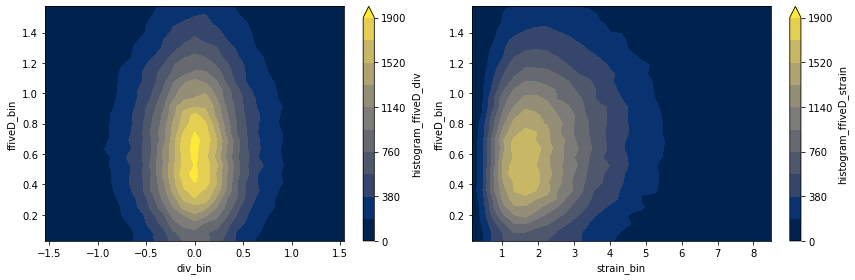

In [148]:
fig, (ax1,ax2) = plt.subplots(nrows=1, ncols=2, figsize=(12,4))
fig.set_tight_layout(True)
hist8.plot.contourf(ax=ax1, cmap='cividis', levels=np.linspace(0,1900,11), extend='max')
hist7.plot.contourf(ax=ax2, cmap='cividis', levels=np.linspace(0,1900,11), extend='max')

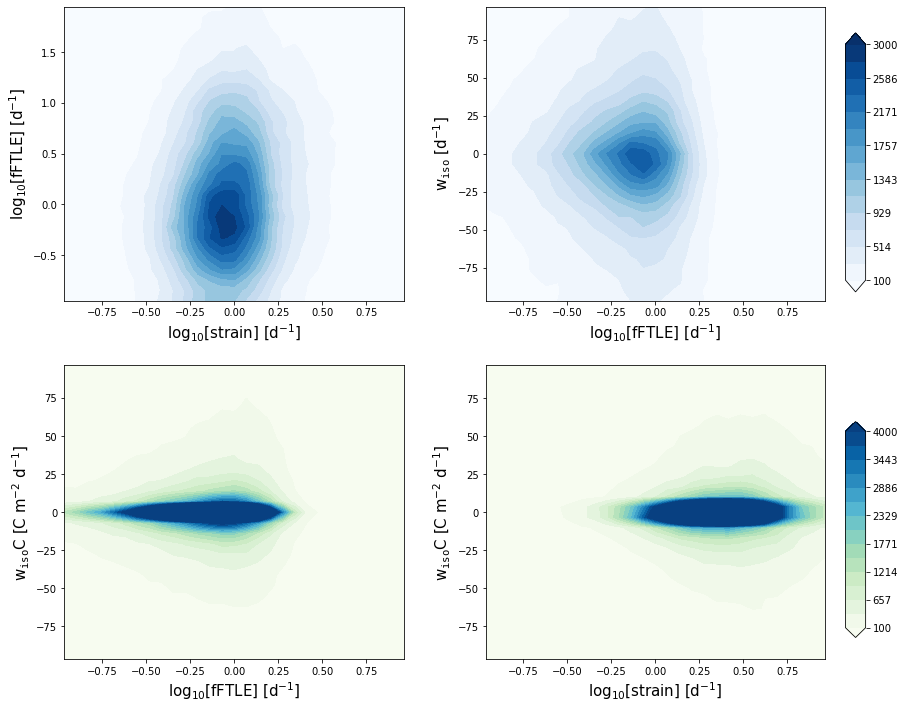

In [323]:
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(14,12))
# fig.set_tight_layout(True)
im1 = axes[0,0].contourf(hist7.strain_bin, hist7.ffiveD_bin, hist1,
#                   norm=clr.LogNorm(), 
                        levels=np.linspace(100,3000,15), extend='both',
                        cmap='Blues')
im2 = axes[0,1].contourf(hist4.ffiveD_bin, 
                        hist4.wiso_bin, hist4,
#                   norm=clr.LogNorm(), 
                        levels=np.linspace(100,3000,15), extend='both',
                        cmap='Blues')
im3 = axes[1,0].contourf(hist2.ffiveD_bin, hist2.wisoC_bin, hist2,
#                   norm=clr.LogNorm(), 
                        levels=np.linspace(100,4000,15), extend='both',
                        cmap='GnBu')
im4 = axes[1,1].contourf(hist3.strain_bin, hist3.wisoC_bin, hist3,
#                   norm=clr.LogNorm(), 
                        levels=np.linspace(100,4000,15), 
                        extend='both',
                        cmap='GnBu')
for c in im1.collections:
    c.set_rasterized(True)
for c in im2.collections:
    c.set_rasterized(True)
for c in im3.collections:
    c.set_rasterized(True)
for c in im4.collections:
    c.set_rasterized(True)
# axes[1,0].set_ylim([0,10])
# axes[1,1].set_ylim([0,10])
# axes[0,1].set_yscale('symlog', linthreshy=0.01)
# axes[1,0].set_yscale('symlog', linthreshy=0.01)
# axes[1,1].set_yscale('symlog', linthreshy=0.01)
# axes[0,1].set_xscale('log')
axes[0,0].set_ylabel(r"$\log_{10}$[fFTLE] [d$^{-1}$]", fontsize=15)
axes[0,0].set_xlabel(r"$\log_{10}$[strain] [d$^{-1}$]", fontsize=15)
axes[0,1].set_ylabel(r"w$_{\tt iso}$ [d$^{-1}$]", fontsize=15)
axes[0,1].set_xlabel(r"$\log_{10}$[fFTLE] [d$^{-1}$]", fontsize=15)
axes[1,0].set_ylabel(r"w$_{\tt iso}$C [C m$^{-2}$ d$^{-1}$]", fontsize=15)
axes[1,0].set_xlabel(r"$\log_{10}$[fFTLE] [d$^{-1}$]", fontsize=15)
axes[1,1].set_ylabel(r"w$_{\tt iso}$C [C m$^{-2}$ d$^{-1}$]", fontsize=15)
axes[1,1].set_xlabel(r"$\log_{10}$[strain] [d$^{-1}$]", fontsize=15)
fig.subplots_adjust(right=0.88, hspace=0.22, wspace=.24)
cbar_ax1 = fig.add_axes([0.9, 0.55, 0.02, 0.3])
cbar = fig.colorbar(im1, cax=cbar_ax1)
cbar_ax3 = fig.add_axes([0.9, 0.15, 0.02, 0.25])
cbar = fig.colorbar(im3, cax=cbar_ax3)
plt.savefig(op.join(ddir,'Figures/twoDhist-strain-Forward_wisoC_z400_y700-1300_x1200-1800.pdf'))

([array([  0.,   0.,  11.,  78., 200., 194.,  88.,  23.,   6.,   0.]),
  array([  0.,   2.,  18.,  76., 194., 195.,  89.,  21.,   5.,   0.]),
  array([  0.,   2.,  13.,  79., 203., 197.,  73.,  26.,   7.,   0.]),
  array([  0.,   1.,  13.,  88., 209., 181.,  83.,  21.,   4.,   0.]),
  array([  0.,   1.,  14.,  97., 202., 189.,  81.,  15.,   1.,   0.]),
  array([  0.,   0.,  21.,  92., 210., 196.,  69.,  11.,   1.,   0.]),
  array([  0.,   2.,  27.,  74., 221., 188.,  75.,  13.,   0.,   0.]),
  array([  0.,   5.,  20.,  90., 198., 200.,  75.,  12.,   0.,   0.]),
  array([  0.,   2.,  20.,  95., 183., 207.,  80.,  13.,   0.,   0.]),
  array([  0.,   0.,  26.,  93., 176., 214.,  81.,  10.,   0.,   0.]),
  array([  0.,   2.,  23.,  88., 176., 212.,  89.,   9.,   1.,   0.]),
  array([  0.,   0.,  25.,  75., 191., 196.,  97.,  15.,   1.,   0.]),
  array([  0.,   1.,  18.,  79., 199., 196.,  83.,  23.,   1.,   0.]),
  array([  0.,   3.,   9.,  97., 197., 191.,  87.,  15.,   1.,   0.]),
  arra

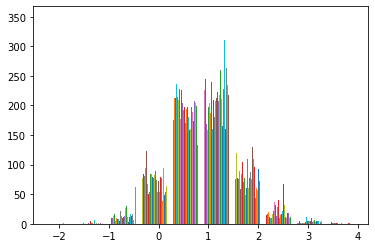

In [179]:
plt.hist(np.log(strain*86400), bins=10)

In [118]:
with ProgressBar():
    wisoC200 = (wiso200*grid.interp(dsnap.PTRACER01[nt],'Z',boundary='fill')[nz200]
               ).sel(XC=slice(2e5,8e5),YC=slice(7e5,13e5)).compute()
#     dwisocdz400 = dwcdz[:,36].sel(XC=slice(2e5,8e5),YC=slice(7e5,13e5)).compute()
# dwcdz400
wisoC200
#     wc200 = wc[:,28].sel(YC=slice(7e5,13e5),XC=slice(2e5,8e5)).compute()
#     dwcdz200 = dwcdz[:,28].sel(YC=slice(7e5,13e5),XC=slice(2e5,8e5)).compute()

[########################################] | 100% Completed |  4.1s


<xarray.DataArray (YC: 600, XC: 600)>
array([[-3.036435e-06, -3.339122e-06, -2.833770e-06, ...,  1.177433e-04,
         1.466369e-04,  1.066969e-04],
       [-3.145704e-06, -3.381050e-06, -2.278164e-06, ...,  1.367187e-04,
         1.698280e-04,  1.246669e-04],
       [-3.519714e-06, -3.320594e-06, -1.458523e-06, ...,  1.287953e-04,
         1.500331e-04,  1.206811e-04],
       ...,
       [-1.763187e-03, -1.957850e-03, -1.838497e-03, ...,  5.297479e-04,
         4.009463e-04,  1.621934e-04],
       [-1.829922e-03, -1.965442e-03, -1.593465e-03, ...,  4.764647e-04,
         5.055279e-04,  3.978200e-04],
       [-7.231351e-04, -9.501334e-04, -1.096293e-03, ...,  2.028576e-04,
         2.307584e-04,  4.065973e-04]], dtype=float32)
Coordinates:
    time     int64 12441600
    Zl       >f4 -199.25
  * YC       (YC) >f4 700500.0 701500.0 702500.0 ... 1298500.0 1299500.0
  * XC       (XC) >f4 200500.0 201500.0 202500.0 ... 797500.0 798500.0 799500.0
    rA       (YC, XC) >f4 1000000.0 1000000

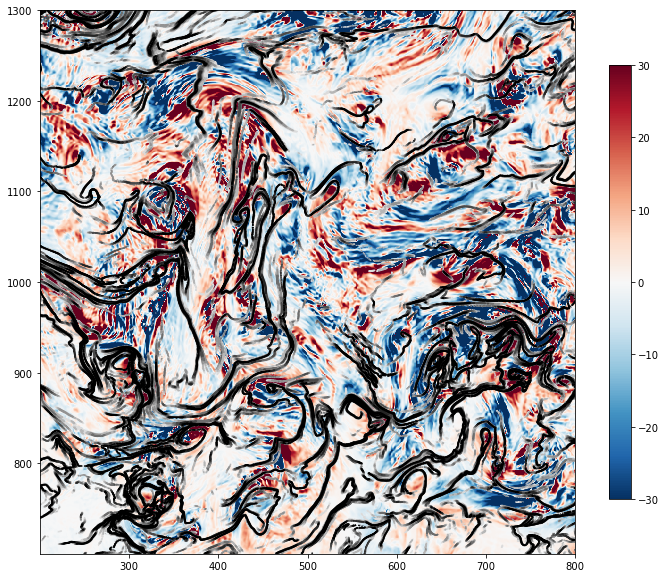

In [123]:
fig, ax = plt.subplots(figsize=(12,10))
# ax.pcolormesh(FTLE.x0.sel(x0=slice(None,6e5))*1e-3, FTLE.y0.sel(y0=slice(2e5,8e5))*1e-3, 
#               FTLE.ftle[1].sel(x0=slice(None,6e5),y0=slice(2e5,8e5)), vmin=0.1, vmax=1.4)
im = ax.pcolormesh(wisoC200.XC*1e-3, wisoC200.YC*1e-3, wisoC200*86400, 
                  vmin=-30, vmax=30, cmap='RdBu_r')
# im = ax.pcolormesh(wc.XG*1e-3, wc.YG*1e-3, np.abs(wc[0]*86400), 
#                   vmin=0, vmax=10, cmap='Reds')
# cs = ax.contour(ftle05.XG*1e-3, ftle05.YG*1e-3,
#               ftle05.where((ftle05<=FTLE.ftle[0].max()) & (ftle05>=1.)), 
#               levels=np.linspace(1,1.6,8), extend='both', cmap='binary')
cs = ax.contour(fFTLE.x0.sel(x0=slice(2e5,8e5))*1e-3, fFTLE.y0.sel(y0=slice(7e5,13e5))*1e-3,
              fFTLE.ftle[0].sel(y0=slice(7e5,13e5),x0=slice(2e5,8e5)).where(fFTLE.ftle[0]>=1.), 
              levels=np.linspace(1,1.6,8), extend='both', cmap='binary')
for c in cs.collections:
    c.set_rasterized(True)
fig.colorbar(im, ax=ax, shrink=.8)

In [121]:
wisoC200.name = 'wisoC'
# ftle05 = xr.DataArray(npar, dims=['YC','XC'], 
#                       coords={'YC':dsnap.YC.sel(YC=slice(7e5,13e5)),
#                               'XC':dsnap.XC.sel(XC=slice(2e5,8e5))})
# ftle05.name = 'fFTLE'
with ProgressBar():
    hist = xhist(wisoC200*86400, 
#                  fFTLE.ftle[0].sel(y0=slice(7e5,13e5),x0=slice(2e5,8e5)),
                 ftle05.where((ftle05<=fFTLE.ftle[0].max()) & (ftle05>0.)),
                 bins=[np.linspace(-20,20,31),np.linspace(0,2.,31)]
    #              bins=[np.logspace(-2,0.2,20),np.logspace(-5.1,-3.8,30)]
                 ).compute()

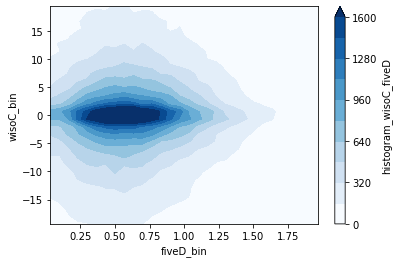

In [124]:
hist.plot.contourf(levels=np.linspace(0,1600,11), extend='max', cmap='Blues')